In [11]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
sns.set_style('whitegrid')
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['xtick.labelsize'] = 8
plt.rcParams['ytick.labelsize'] = 8
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 14
plt.rcParams['figure.figsize'] = (12, 8)
pd.options.mode.chained_assignment = None
pd.options.display.float_format = '{:.2f}'.format
pd.set_option('display.max_columns', 200)
pd.set_option('display.width', 400)
import warnings
warnings.filterwarnings('ignore')
import datetime
import pandas_profiling as pp
from sklearn.model_selection import train_test_split
from sklearn.ensemble import VotingRegressor, RandomForestRegressor, ExtraTreesRegressor, AdaBoostRegressor, GradientBoostingRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import RobustScaler
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.base import clone
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
import lightgbm as lgb

In [12]:
df = pd.read_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\dataset\train.csv')
df.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
0,WM_33725,2019-08-04 14:33:20,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,nan,239.84,2730.31,42.08,BA,Medium,2.22,0.31,24.28,6.77
1,WM_698,2018-11-05 10:13:20,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,nan,337.94,1780.21,107.89,A2,Medium,4.21,0.45,27.26,5.97
2,WM_39146,2019-09-14 14:03:20,95.48,nan,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,ABC,Medium,2.72,0.30,27.37,2.87
3,WM_6757,2018-12-25 15:33:20,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,ABC,NaN,4.86,0.37,24.29,14.85
4,WM_21521,2019-05-04 03:13:20,10.72,nan,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,AAA,Medium,nan,0.45,27.97,3.52


In [13]:
df_test = pd.read_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\dataset\test.csv')
df_test.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m)
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,BA,Medium,3.19,0.40,25.57
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,nan,29.43,42.73,499.60,1165.11,-35.05,A,Medium,3.02,0.44,24.37
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,B2,Medium,2.61,0.39,27.65
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,nan,23.89,13.50,nan,1329.74,15.25,BBB,Low,2.87,0.45,24.19
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,A,Low,3.55,0.37,4.89


In [14]:
# set target feature
targetFeature='windmill_generated_power(kW/h)'

In [15]:
# important funtions
def datasetShape(df):
    rows, cols = df.shape
    print("The dataframe has",rows,"rows and",cols,"columns.")
    
# select numerical and categorical features
def divideFeatures(df):
    numerical_features = df.select_dtypes(include=[np.number])
    categorical_features = df.select_dtypes(include=[np.object])
    return numerical_features, categorical_features

In [16]:
# check dataset shape
datasetShape(df)

The dataframe has 28200 rows and 22 columns.


In [17]:
# check for duplicates
print(df.shape)
df.drop_duplicates(inplace=True)
print(df.shape)

(28200, 22)
(28200, 22)


In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28200 entries, 0 to 28199
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   tracking_id                     28200 non-null  object 
 1   datetime                        28200 non-null  object 
 2   wind_speed(m/s)                 27927 non-null  float64
 3   atmospheric_temperature(°C)     24750 non-null  float64
 4   shaft_temperature(°C)           28198 non-null  float64
 5   blades_angle(°)                 27984 non-null  float64
 6   gearbox_temperature(°C)         28199 non-null  float64
 7   engine_temperature(°C)          28188 non-null  float64
 8   motor_torque(N-m)               28176 non-null  float64
 9   generator_temperature(°C)       28188 non-null  float64
 10  atmospheric_pressure(Pascal)    25493 non-null  float64
 11  area_temperature(°C)            28200 non-null  float64
 12  windmill_body_temperature(°C)   

In [19]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12086 entries, 0 to 12085
Data columns (total 21 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   tracking_id                    12086 non-null  object 
 1   datetime                       12086 non-null  object 
 2   wind_speed(m/s)                11960 non-null  float64
 3   atmospheric_temperature(°C)    10659 non-null  float64
 4   shaft_temperature(°C)          12085 non-null  float64
 5   blades_angle(°)                11980 non-null  float64
 6   gearbox_temperature(°C)        12085 non-null  float64
 7   engine_temperature(°C)         12081 non-null  float64
 8   motor_torque(N-m)              12075 non-null  float64
 9   generator_temperature(°C)      12081 non-null  float64
 10  atmospheric_pressure(Pascal)   10935 non-null  float64
 11  area_temperature(°C)           12085 non-null  float64
 12  windmill_body_temperature(°C)  11160 non-null 

## EDA

In [20]:
profile = pp.ProfileReport(df, title='Pandas Profiling Report', explorative=True)
profile.to_file("profile.html")

In [21]:
profile.to_notebook_iframe()

In [22]:
cont_features, cat_features = divideFeatures(df)
cat_features

,tracking_id,datetime,turbine_status,cloud_level
0,WM_33725,2019-08-04 14:33:20,BA,Medium
1,WM_698,2018-11-05 10:13:20,A2,Medium
2,WM_39146,2019-09-14 14:03:20,ABC,Medium
3,WM_6757,2018-12-25 15:33:20,ABC,NaN
4,WM_21521,2019-05-04 03:13:20,AAA,Medium
...,...,...,...,...
28195,WM_7814,2019-01-02 02:43:20,BB,Medium
28196,WM_32512,2019-07-26 12:53:20,BB,Low
28197,WM_5193,2018-12-12 02:13:20,D,Medium
28198,WM_12173,2019-02-03 19:13:20,BCB,Low


In [23]:
cont_features

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
0,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,nan,239.84,2730.31,42.08,2.22,0.31,24.28,6.77
1,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,nan,337.94,1780.21,107.89,4.21,0.45,27.26,5.97
2,95.48,nan,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,2.72,0.30,27.37,2.87
3,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,4.86,0.37,24.29,14.85
4,10.72,nan,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,nan,0.45,27.97,3.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28195,94.77,23.58,45.40,5.38,-1.09,48.53,2791.60,90.90,19428.73,45.43,44.24,536.15,1980.86,45.91,2.77,0.42,24.59,9.59
28196,94.20,24.03,42.07,-99.00,44.29,43.49,2207.88,72.24,16596.49,25.14,43.62,354.24,1712.84,36.97,-3.25,0.46,26.05,4.52
28197,94.16,28.67,45.00,9.55,49.38,44.04,2801.66,94.81,19083.88,45.13,43.58,534.21,1951.73,88.32,nan,0.38,28.53,11.10
28198,95.43,26.56,48.03,3.05,81.44,44.82,2760.65,90.14,18360.79,45.60,44.97,568.50,1968.92,47.56,3.00,0.35,47.75,9.37


In [24]:
df.nunique()

tracking_id                       28200
datetime                          28200
wind_speed(m/s)                   27727
atmospheric_temperature(°C)       20809
shaft_temperature(°C)             27625
blades_angle(°)                   22830
gearbox_temperature(°C)           27911
engine_temperature(°C)            28188
motor_torque(N-m)                 27660
generator_temperature(°C)         28187
atmospheric_pressure(Pascal)      25492
area_temperature(°C)              28170
windmill_body_temperature(°C)     21893
wind_direction(°)                 22984
resistance(ohm)                   27365
rotor_torque(N-m)                 25945
turbine_status                       14
cloud_level                           3
blade_length(m)                   22833
blade_breadth(m)                  28200
windmill_height(m)                27657
windmill_generated_power(kW/h)    27988
dtype: int64

In [25]:
df_test.nunique()

tracking_id                      12086
datetime                         12086
wind_speed(m/s)                  11875
atmospheric_temperature(°C)       8988
shaft_temperature(°C)            11839
blades_angle(°)                   9820
gearbox_temperature(°C)          11952
engine_temperature(°C)           12081
motor_torque(N-m)                11856
generator_temperature(°C)        12081
atmospheric_pressure(Pascal)     10935
area_temperature(°C)             12075
windmill_body_temperature(°C)     9459
wind_direction(°)                 9885
resistance(ohm)                  11727
rotor_torque(N-m)                11128
turbine_status                      14
cloud_level                          3
blade_length(m)                   9849
blade_breadth(m)                 12086
windmill_height(m)               11831
dtype: int64

In [26]:
df.isna().sum()

tracking_id                          0
datetime                             0
wind_speed(m/s)                    273
atmospheric_temperature(°C)       3450
shaft_temperature(°C)                2
blades_angle(°)                    216
gearbox_temperature(°C)              1
engine_temperature(°C)              12
motor_torque(N-m)                   24
generator_temperature(°C)           12
atmospheric_pressure(Pascal)      2707
area_temperature(°C)                 0
windmill_body_temperature(°C)     2363
wind_direction(°)                 5103
resistance(ohm)                      1
rotor_torque(N-m)                  572
turbine_status                    1759
cloud_level                        276
blade_length(m)                   5093
blade_breadth(m)                     0
windmill_height(m)                 543
windmill_generated_power(kW/h)     207
dtype: int64

In [27]:
df_test.isna().sum()

tracking_id                         0
datetime                            0
wind_speed(m/s)                   126
atmospheric_temperature(°C)      1427
shaft_temperature(°C)               1
blades_angle(°)                   106
gearbox_temperature(°C)             1
engine_temperature(°C)              5
motor_torque(N-m)                  11
generator_temperature(°C)           5
atmospheric_pressure(Pascal)     1151
area_temperature(°C)                1
windmill_body_temperature(°C)     926
wind_direction(°)                2160
resistance(ohm)                     0
rotor_torque(N-m)                 281
turbine_status                    797
cloud_level                       125
blade_length(m)                  2114
blade_breadth(m)                    0
windmill_height(m)                255
dtype: int64

In [28]:
# correlation heatmap for all features
def plot_correlation(data):
    corr = data.corr()
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    sns.heatmap(corr, mask = mask, annot=True)
    plt.show()

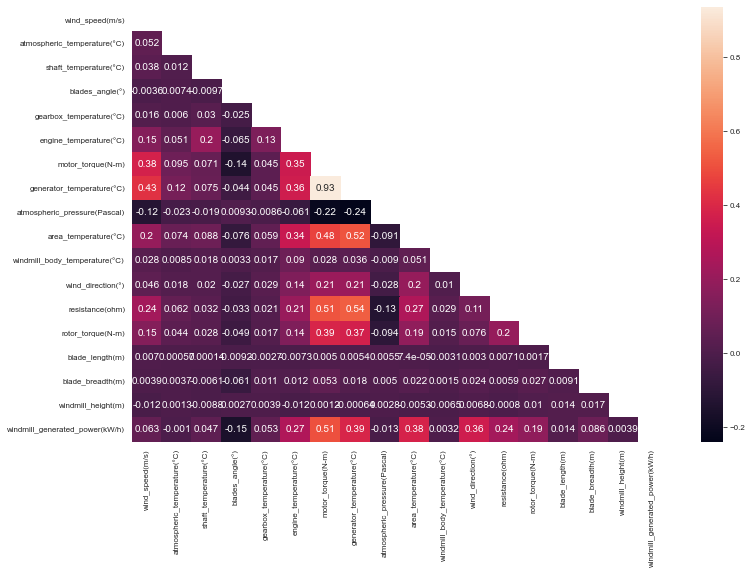

In [29]:
plot_correlation(data=df)

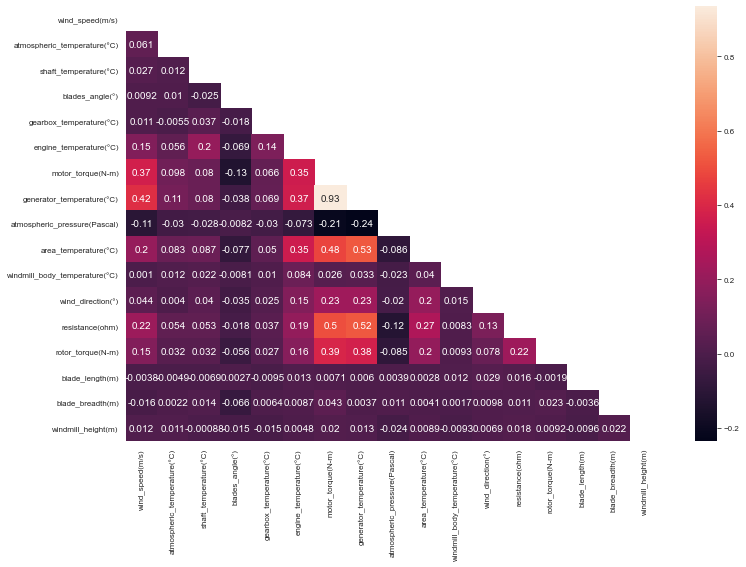

In [30]:
plot_correlation(data=df_test)

In [31]:
# plot sample skewed feature
def plot_skewed_feature(data):
    plt.figure(figsize=(10,4))
    sns.distplot(data[targetFeature])
    plt.show()

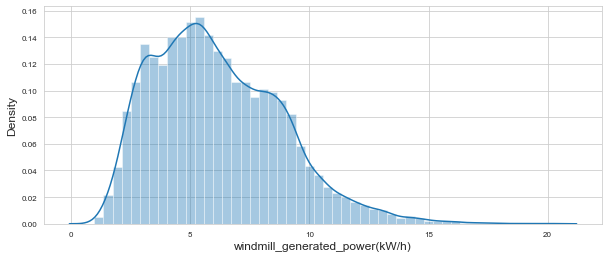

In [32]:
plot_skewed_feature(data=df)

In [33]:
skewed_features = cont_features.apply(lambda x: x.skew()).sort_values(ascending=False)
skewed_features

gearbox_temperature(°C)           0.89
windmill_generated_power(kW/h)    0.69
wind_direction(°)                 0.17
atmospheric_pressure(Pascal)      0.06
motor_torque(N-m)                 0.03
wind_speed(m/s)                  -0.06
windmill_height(m)               -0.11
generator_temperature(°C)        -0.19
blade_breadth(m)                 -0.19
area_temperature(°C)             -0.63
blades_angle(°)                  -0.65
resistance(ohm)                  -0.70
rotor_torque(N-m)                -1.03
atmospheric_temperature(°C)      -1.67
windmill_body_temperature(°C)    -2.24
shaft_temperature(°C)            -2.53
engine_temperature(°C)           -3.94
blade_length(m)                  -8.61
dtype: float64

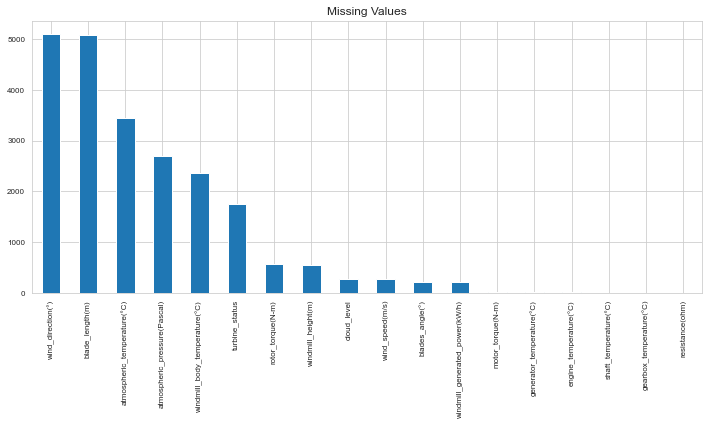

In [34]:
# plot missing values

def calc_missing(data):
    missing = data.isna().sum().sort_values(ascending=False)
    missing = missing[missing != 0]
    missing_perc = missing/data.shape[0]*100
    return missing, missing_perc

if df.isna().any().sum()>0:
    missing, missing_perc = calc_missing(data=df)
    missing.plot(kind='bar',figsize=(12,5))
    plt.title('Missing Values')
    plt.show()
else:
    print("No Missing Values")

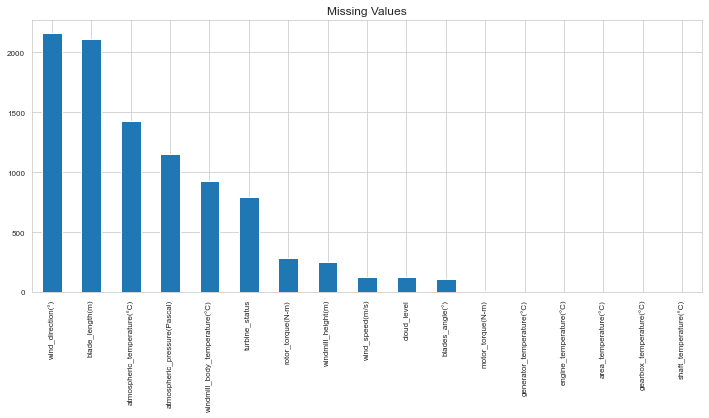

In [35]:
if df_test.isna().any().sum()>0:
    missing, missing_perc = calc_missing(data=df_test)
    missing.plot(kind='bar',figsize=(12,5))
    plt.title('Missing Values')
    plt.show()
else:
    print("No Missing Values")

In [36]:
# remove all columns having no values
df.dropna(axis=1, how="all", inplace=True)
df.dropna(axis=0, how="all", inplace=True)
datasetShape(df)

The dataframe has 28200 rows and 22 columns.


In [37]:
df.describe()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h)
count,27927.00,24750.00,28198.00,27984.00,28199.00,28188.00,28176.00,28188.00,25493.00,28200.00,25837.00,23097.00,28199.00,27628.00,23107.00,28200.00,27657.00,27993.00
mean,69.04,0.38,40.09,-9.65,41.03,42.61,1710.82,65.03,53185.06,32.74,20.80,306.89,1575.56,25.85,2.25,0.40,25.89,6.13
std,76.28,44.28,27.20,47.92,43.66,6.12,827.21,19.82,187503.62,7.70,54.36,134.06,483.33,32.42,11.28,0.06,7.77,2.70
min,-496.21,-99.00,-99.00,-146.26,-244.97,3.17,500.00,33.89,-1188624.13,-30.00,-999.00,0.00,-1005.22,-136.73,-99.00,0.20,-30.30,0.96
25%,20.88,7.95,41.63,-1.20,40.56,41.91,870.34,41.20,16794.92,27.31,40.45,238.63,1268.13,13.72,2.54,0.35,24.45,4.06
50%,93.30,16.10,43.69,-0.50,43.22,43.53,2031.85,70.73,18191.13,32.61,42.79,271.43,1678.24,32.98,3.45,0.40,25.96,5.76
75%,95.27,23.69,45.67,5.50,45.88,45.17,2462.59,78.95,118113.29,38.23,44.49,404.15,1829.05,41.55,4.36,0.45,27.48,7.95
max,601.46,80.22,169.82,165.93,999.00,50.00,3000.00,100.00,1272551.90,55.00,323.00,569.97,4693.48,236.88,18.21,0.50,78.35,20.18


## Comparing train and test data And Outlier handling

In [38]:
# function to create histogram, Q-Q plot and boxplot

def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 5, 1)
    sns.histplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 5, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('Variable quantiles')

    # boxplot
    plt.subplot(1, 5, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')
    
    plt.show()

In [39]:
def comparing_train_and_test_feature(df,df_test,col):
    fig = plt.figure(figsize=(16,10))
    ax0 = fig.add_subplot(1,2,1)
    ax1 = fig.add_subplot(1,2,2)
    df[col].plot(kind='kde',ax=ax0)
    df_test[col].plot(kind='kde',ax=ax1)
    ax0.set_xlabel(col)
    ax1.set_xlabel(col)
    ax0.set_title("Density plot of " + str(col) + " of training set")
    ax1.set_title("Density plot of " + str(col) + " of testing set")
    plt.show()

__wind_speed(m/s)__

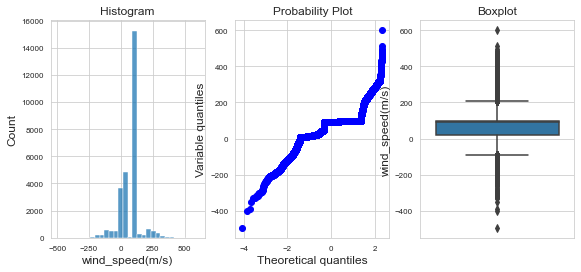

In [40]:
diagnostic_plots(df, 'wind_speed(m/s)')

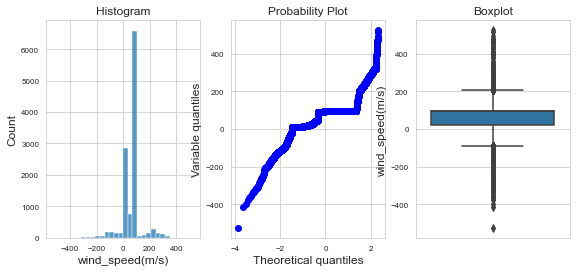

In [41]:
diagnostic_plots(df_test, 'wind_speed(m/s)')

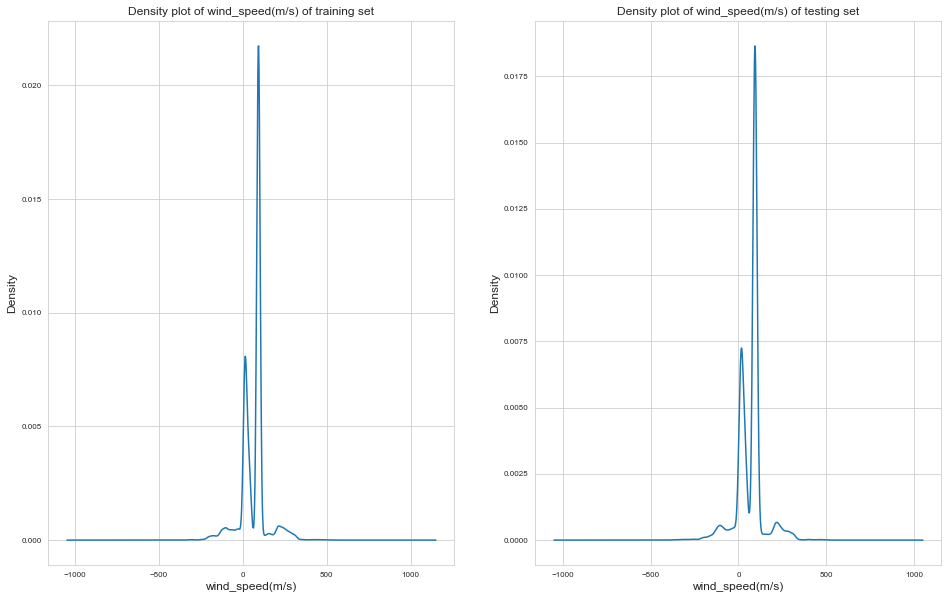

In [42]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'wind_speed(m/s)')
## Distribution of Feature wind_speed(m/s) of training and testing dataset are very similar

<AxesSubplot:xlabel='wind_speed(m/s)', ylabel='windmill_generated_power(kW/h)'>

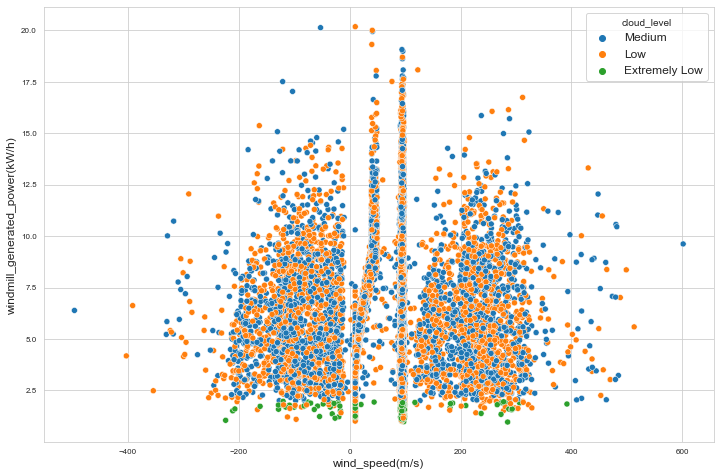

In [43]:
sns.scatterplot(x='wind_speed(m/s)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__atmospheric_temperature(°C)__

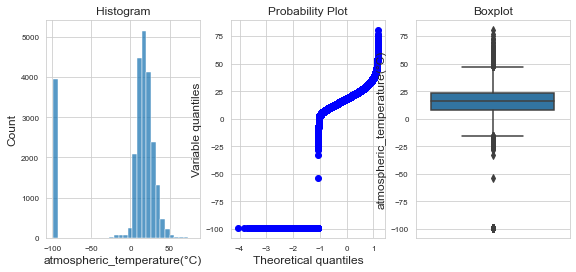

In [44]:
diagnostic_plots(df, 'atmospheric_temperature(°C)')

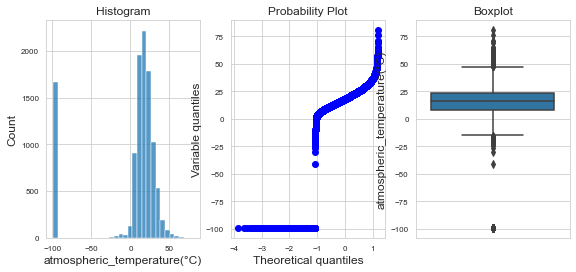

In [45]:
diagnostic_plots(df_test, 'atmospheric_temperature(°C)')

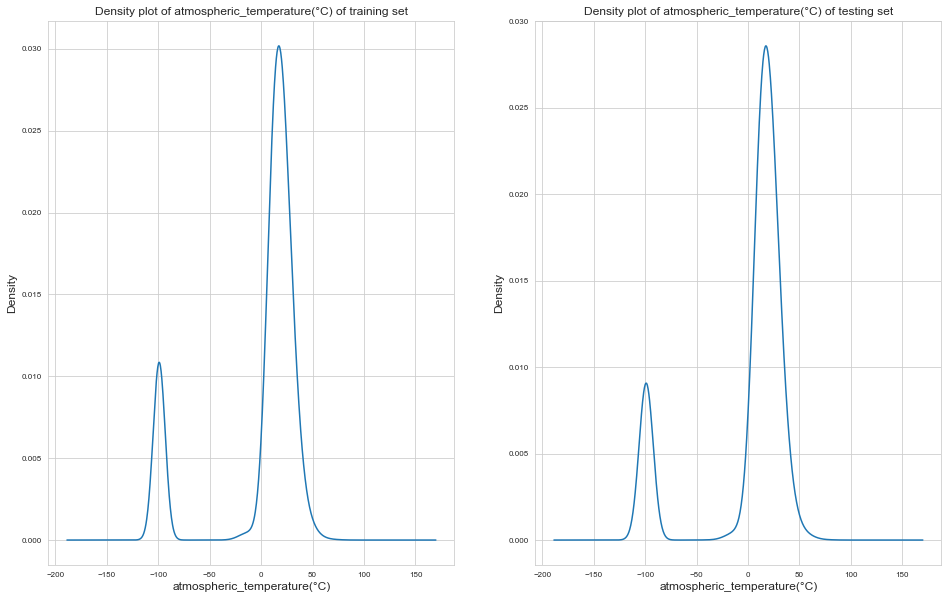

In [46]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'atmospheric_temperature(°C)')
## Distribution of Feature "atmospheric_temperature(°C)" of training and testing dataset is very similar

<AxesSubplot:xlabel='atmospheric_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

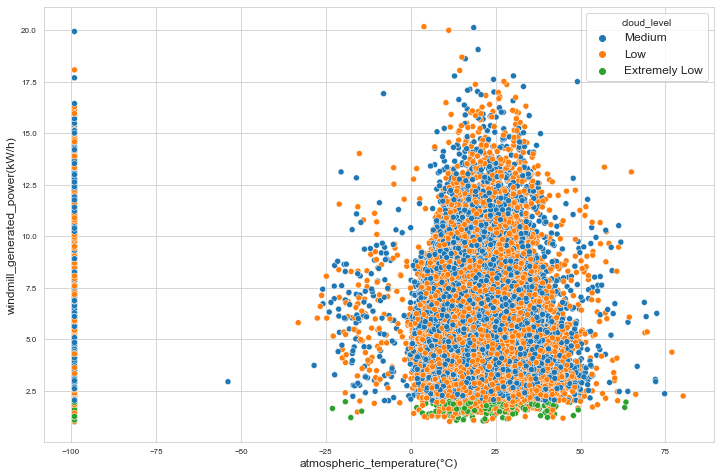

In [47]:
sns.scatterplot(x='atmospheric_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__shaft_temperature(°C)__

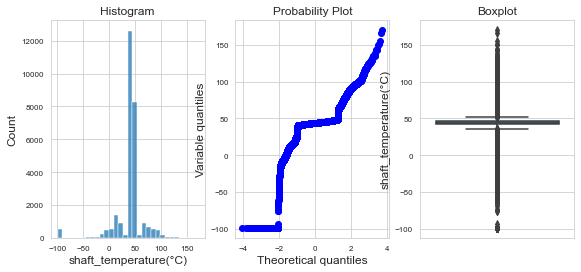

In [48]:
diagnostic_plots(df, 'shaft_temperature(°C)')

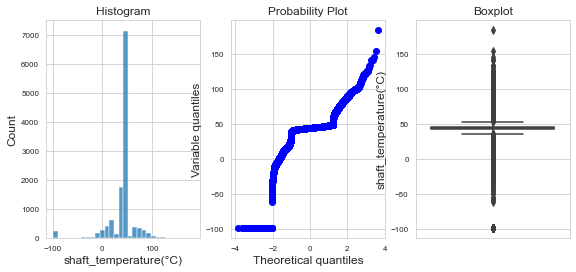

In [49]:
diagnostic_plots(df_test, 'shaft_temperature(°C)')

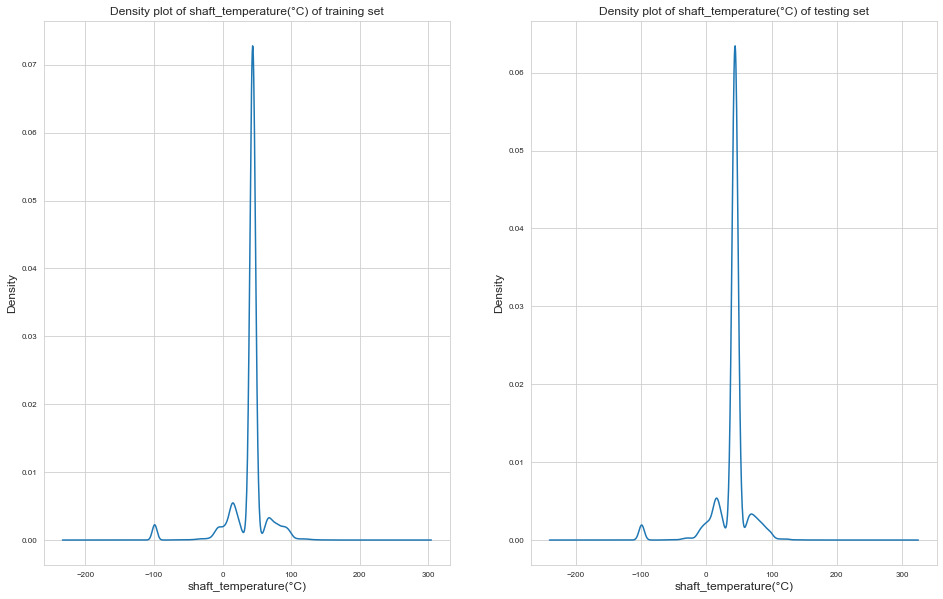

In [50]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'shaft_temperature(°C)')
## Distribution of Feature "shaft_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='shaft_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

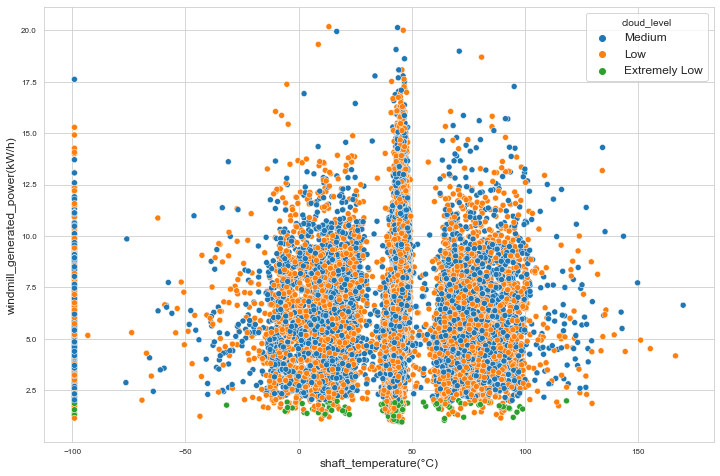

In [51]:
sns.scatterplot(x='shaft_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

<AxesSubplot:xlabel='shaft_temperature(°C)', ylabel='wind_speed(m/s)'>

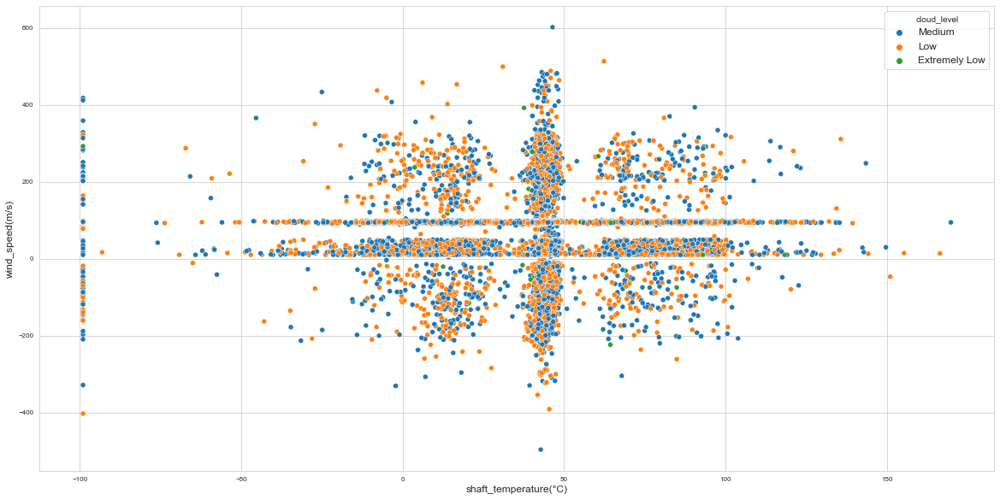

In [52]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='shaft_temperature(°C)',y='wind_speed(m/s)',hue='cloud_level',data=df)

__blades_angle(°)__

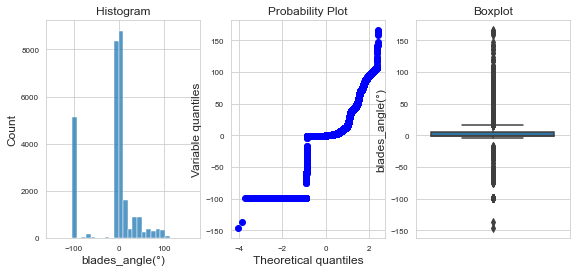

In [53]:
diagnostic_plots(df, 'blades_angle(°)')

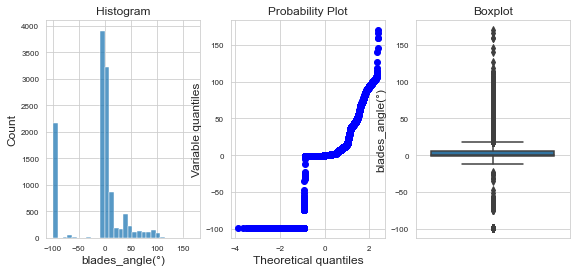

In [54]:
diagnostic_plots(df_test, 'blades_angle(°)')

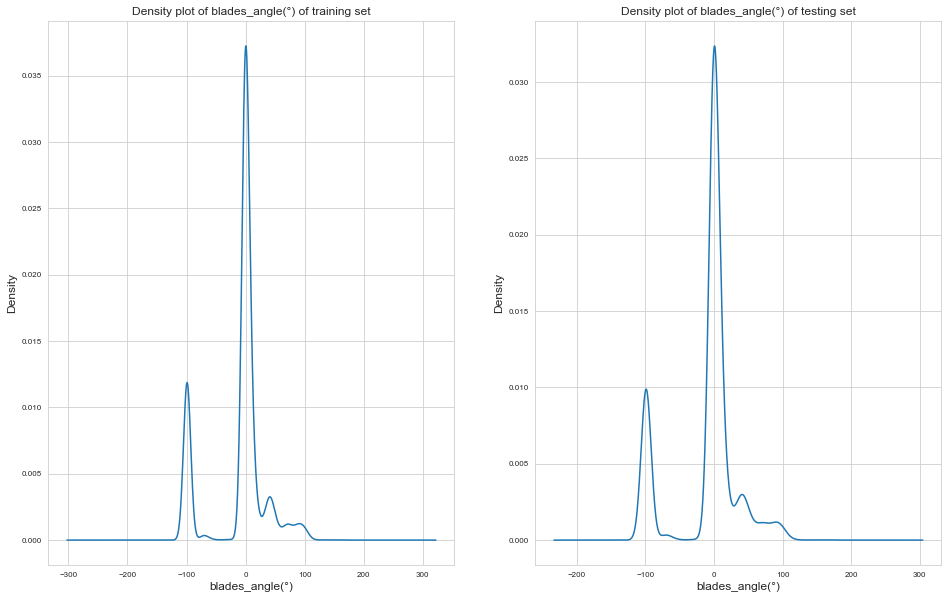

In [55]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blades_angle(°)')
## Distribution of Feature "blades_angle(°)" of training and testing dataset are almost same

<AxesSubplot:xlabel='blades_angle(°)', ylabel='windmill_generated_power(kW/h)'>

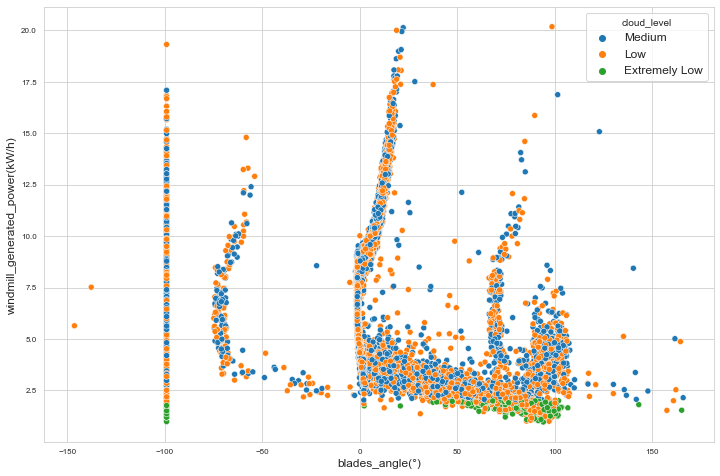

In [56]:
sns.scatterplot(x='blades_angle(°)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__gearbox_temperature(°C)__

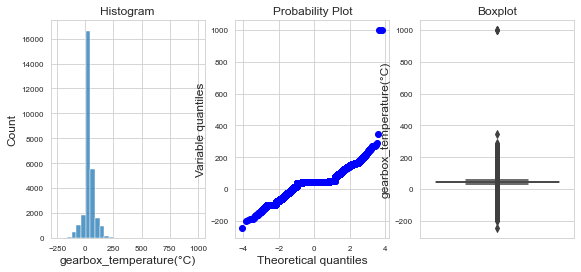

In [57]:
diagnostic_plots(df, 'gearbox_temperature(°C)')

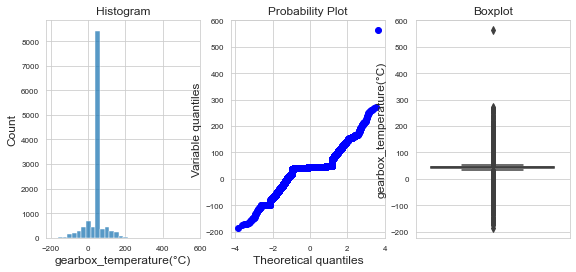

In [58]:
diagnostic_plots(df_test, 'gearbox_temperature(°C)')

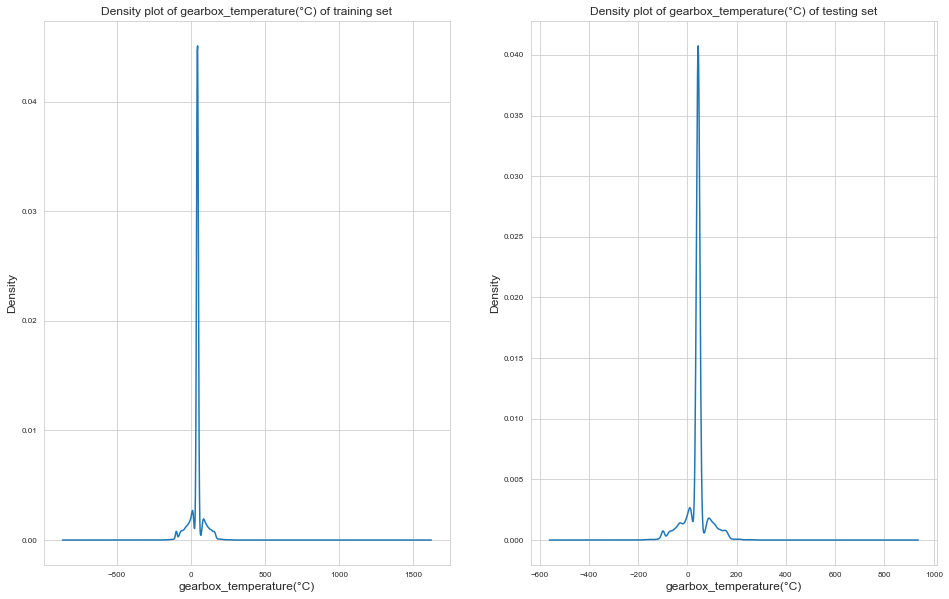

In [59]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'gearbox_temperature(°C)')
## Distribution of Feature "gearbox_temperature(°C)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='gearbox_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

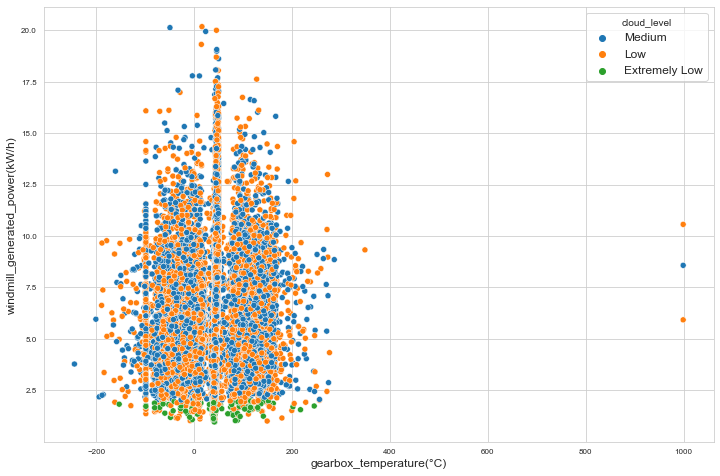

In [60]:
sns.scatterplot(x='gearbox_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [61]:
## Here we are removing extreme outliers which are present in a very less number
low = df['gearbox_temperature(°C)'] < -200
high = df['gearbox_temperature(°C)'] > 300
low = np.where(low)
high = np.where(high)
df.drop(low[0],inplace=True)
df.drop(high[0],inplace=True)
df.index = range(df.shape[0])

__engine_temperature(°C)__

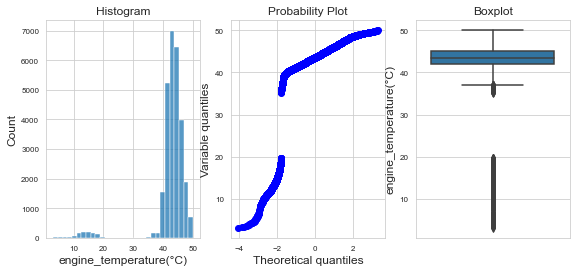

In [62]:
diagnostic_plots(df, 'engine_temperature(°C)')

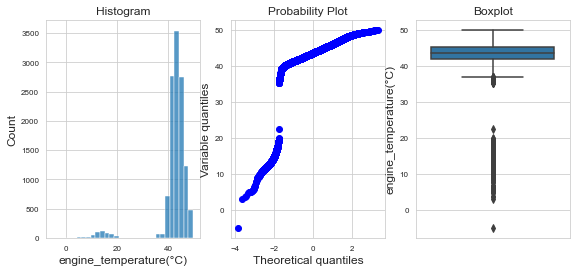

In [63]:
diagnostic_plots(df_test, 'engine_temperature(°C)')

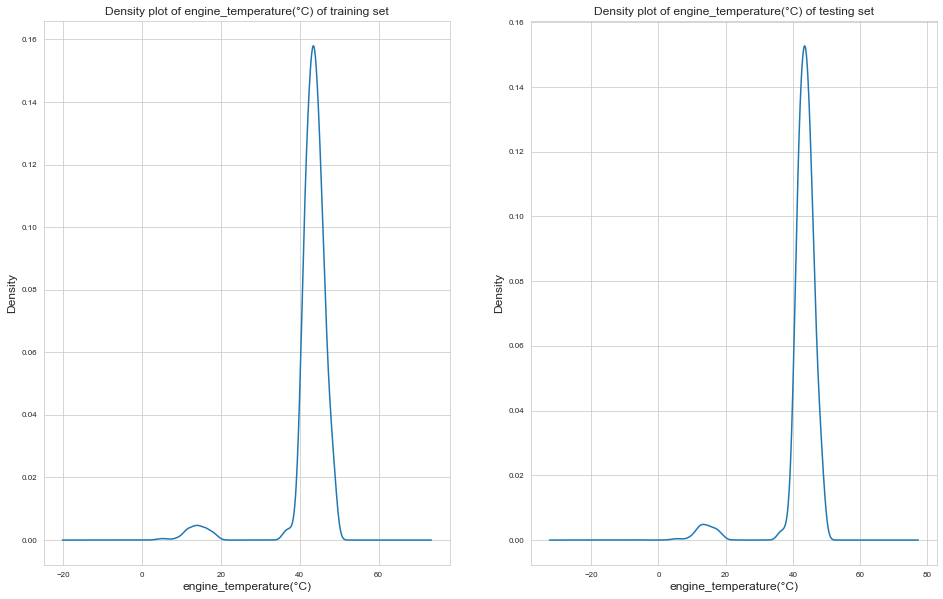

In [64]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'engine_temperature(°C)')
## Distribution of Feature "engine_temperature(°C)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='engine_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

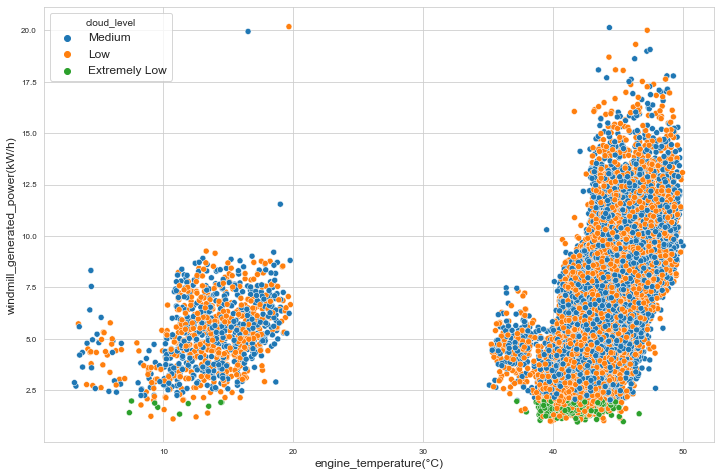

In [65]:
sns.scatterplot(x='engine_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [66]:
## Dropping extreme outliers
low = df['engine_temperature(°C)'] < 38
low = np.where(low)
df.drop(low[0],inplace=True)
df.index = range(df.shape[0])

<AxesSubplot:xlabel='engine_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

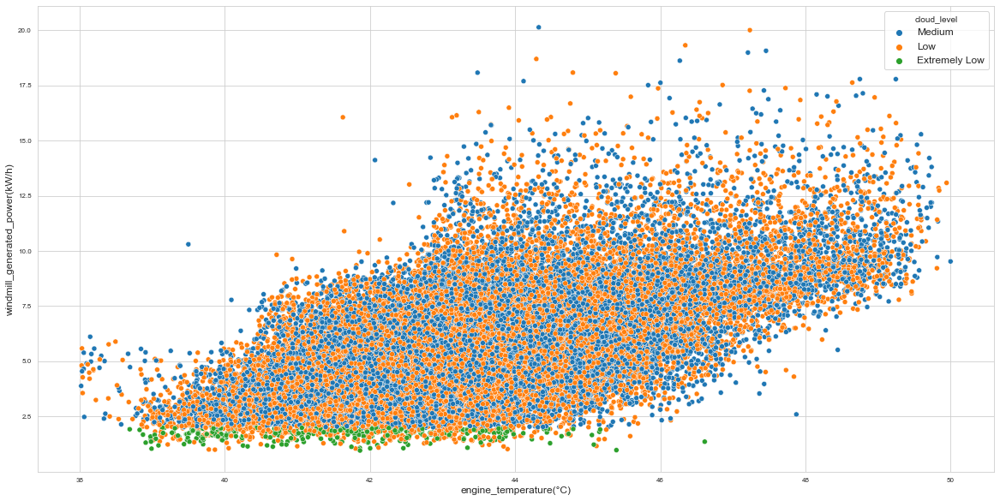

In [67]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='engine_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__motor_torque(N-m)__

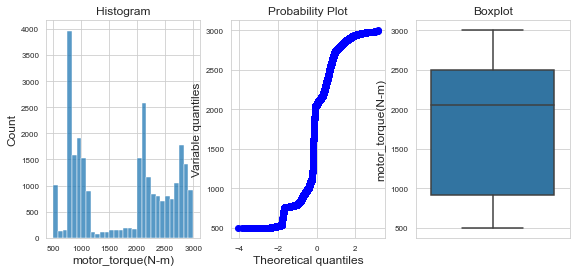

In [68]:
diagnostic_plots(df, 'motor_torque(N-m)')

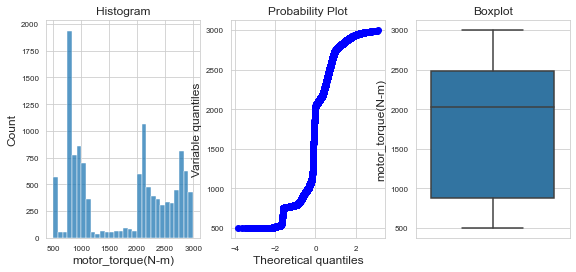

In [69]:
diagnostic_plots(df_test, 'motor_torque(N-m)')

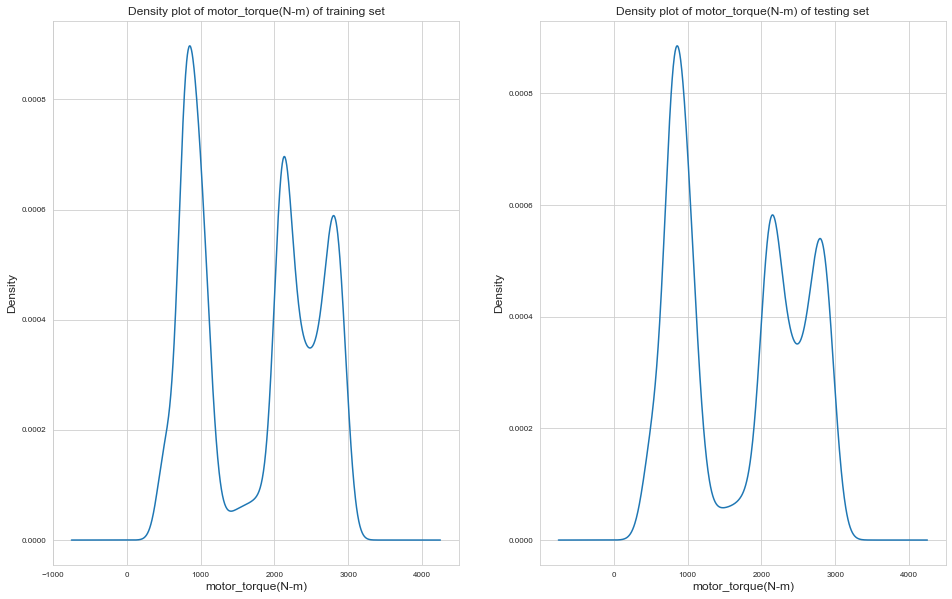

In [70]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'motor_torque(N-m)')
## Distribution of Feature "motor_torque(N-m)" of training and testing dataset are almost similar

<AxesSubplot:xlabel='motor_torque(N-m)', ylabel='windmill_generated_power(kW/h)'>

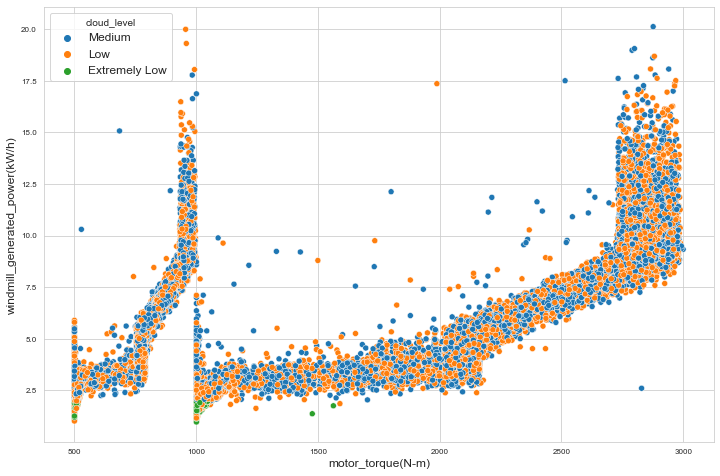

In [71]:
sns.scatterplot(x='motor_torque(N-m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__generator_temperature(°C)__

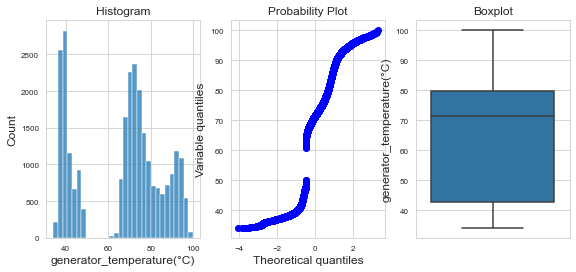

In [72]:
diagnostic_plots(df, 'generator_temperature(°C)')

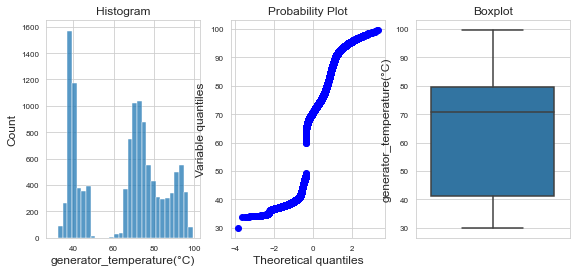

In [73]:
diagnostic_plots(df_test, 'generator_temperature(°C)')

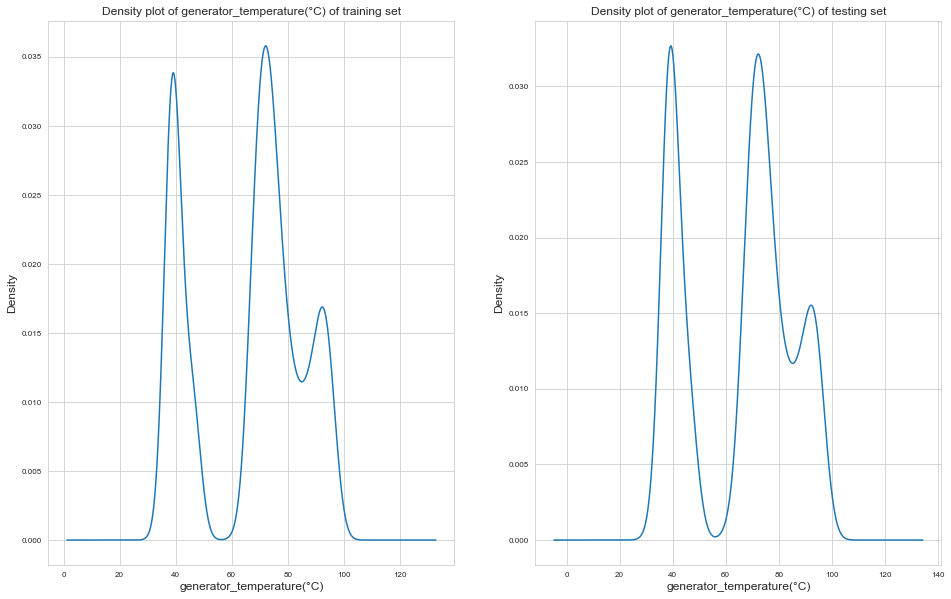

In [74]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'generator_temperature(°C)')
## Distribution of Feature "generator_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='generator_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

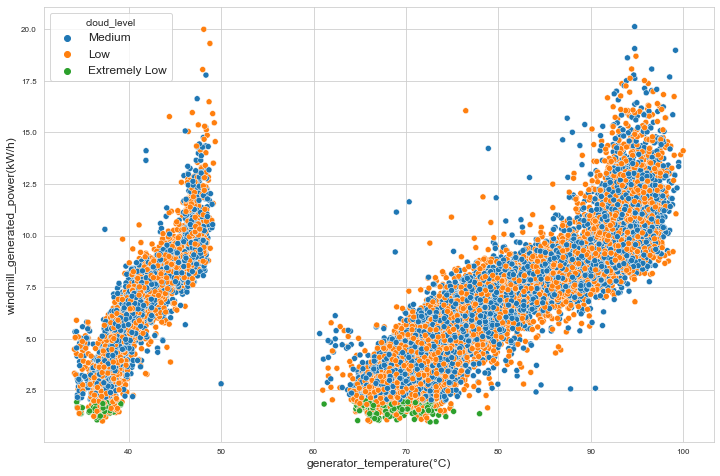

In [75]:
sns.scatterplot(x='generator_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__atmospheric_pressure(Pascal)__

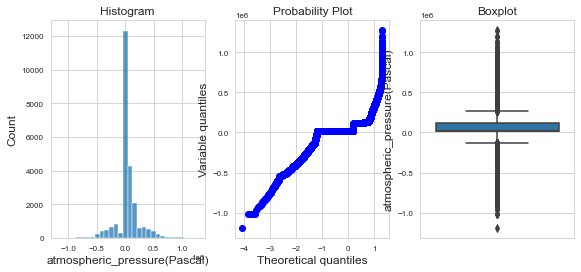

In [76]:
diagnostic_plots(df, 'atmospheric_pressure(Pascal)')

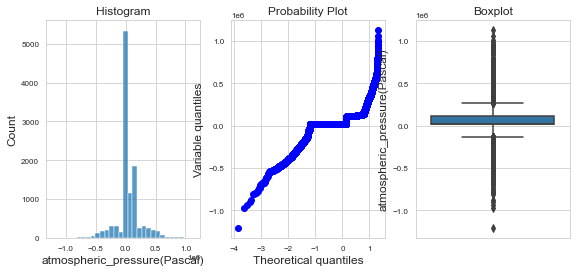

In [77]:
diagnostic_plots(df_test, 'atmospheric_pressure(Pascal)')

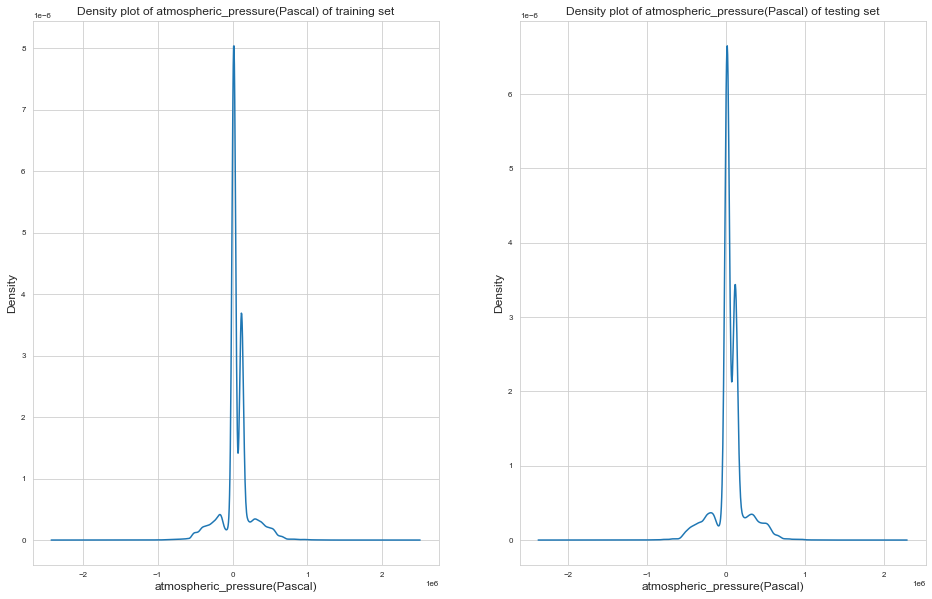

In [78]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'atmospheric_pressure(Pascal)')
## Distribution of Feature "atmospheric_pressure(Pascal)" of training and testing dataset are almost same

<AxesSubplot:xlabel='atmospheric_pressure(Pascal)', ylabel='windmill_generated_power(kW/h)'>

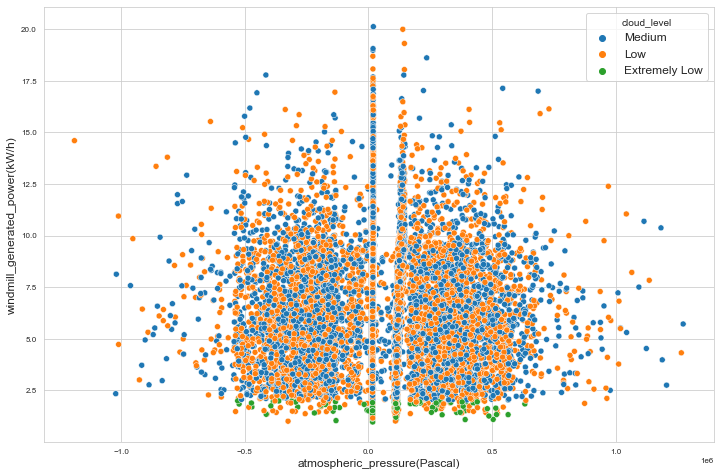

In [79]:
sns.scatterplot(x='atmospheric_pressure(Pascal)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__area_temperature(°C)__

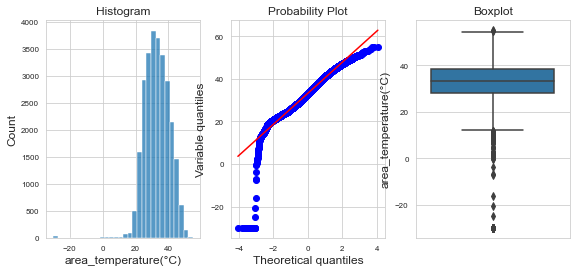

In [80]:
diagnostic_plots(df, 'area_temperature(°C)')

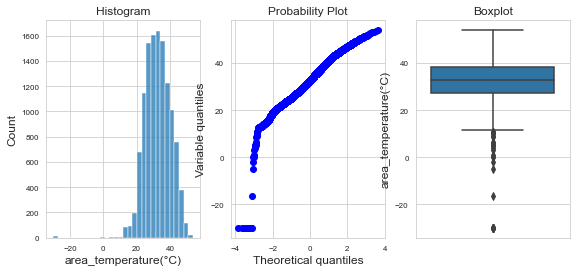

In [81]:
diagnostic_plots(df_test, 'area_temperature(°C)')

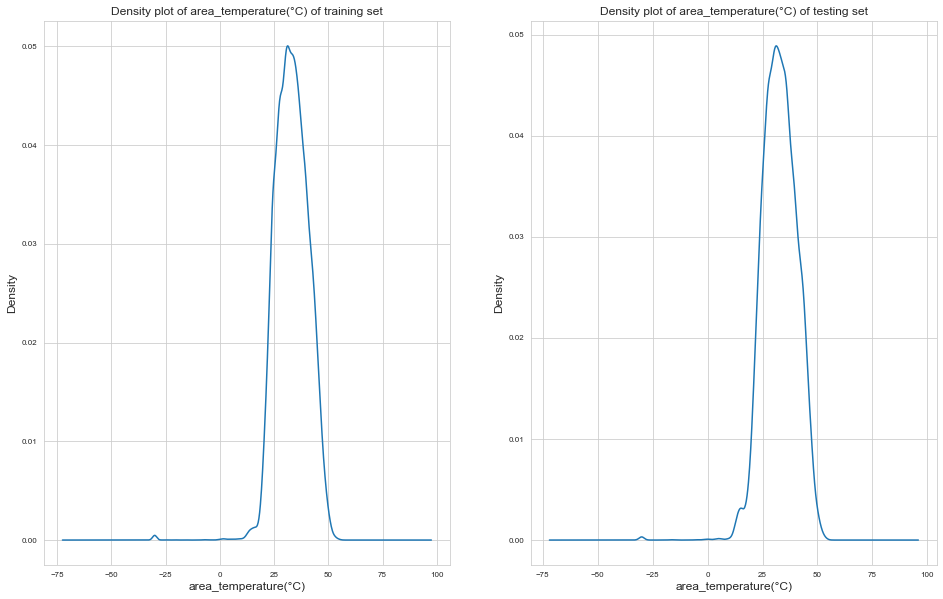

In [82]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'area_temperature(°C)')
## Distribution of Feature "area_temperature(°C)" of training and testing dataset are almost same

<AxesSubplot:xlabel='area_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

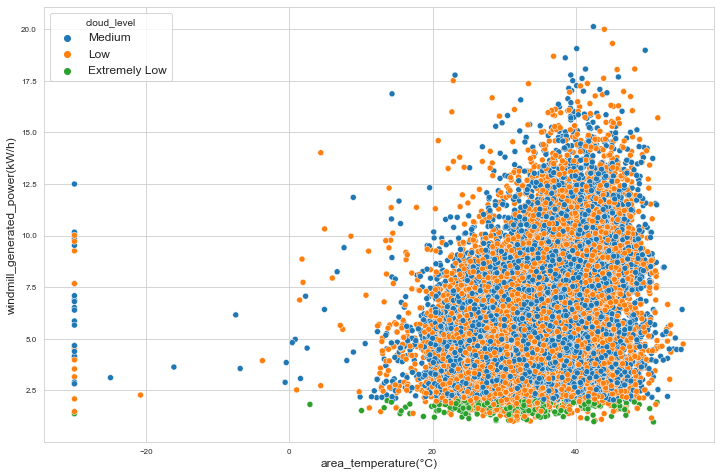

In [83]:
sns.scatterplot(x='area_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [84]:
## Droping extreme outliers
low = df['area_temperature(°C)'] < 10
low = np.where(low)
df.drop(low[0],inplace=True)
df.index = range(df.shape[0])

<AxesSubplot:xlabel='area_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

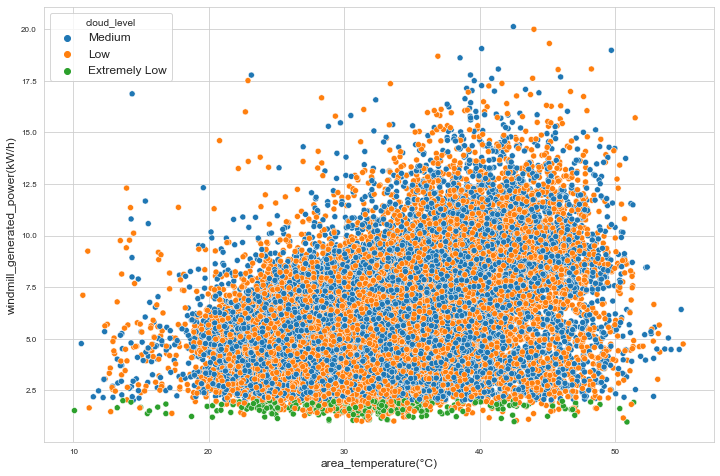

In [85]:
sns.scatterplot(x='area_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__windmill_body_temperature(°C)__

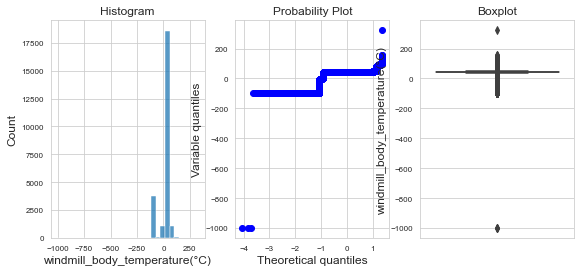

In [86]:
diagnostic_plots(df, 'windmill_body_temperature(°C)')

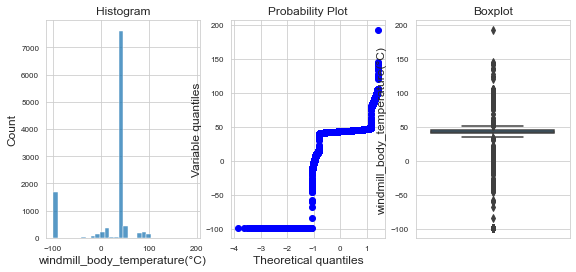

In [87]:
diagnostic_plots(df_test, 'windmill_body_temperature(°C)')

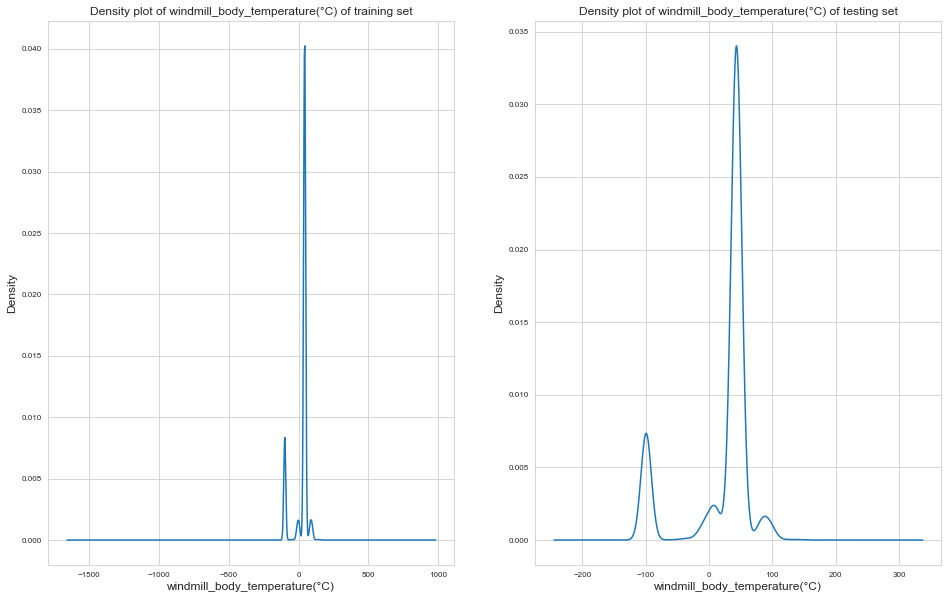

In [88]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'windmill_body_temperature(°C)')
## Distribution of Feature "windmill_body_temperature(°C)" of training and testing dataset is little bit different
## as density plot of windmill_body_temperature(°C) in testing dataset is broader than in training set

<AxesSubplot:xlabel='windmill_body_temperature(°C)', ylabel='windmill_generated_power(kW/h)'>

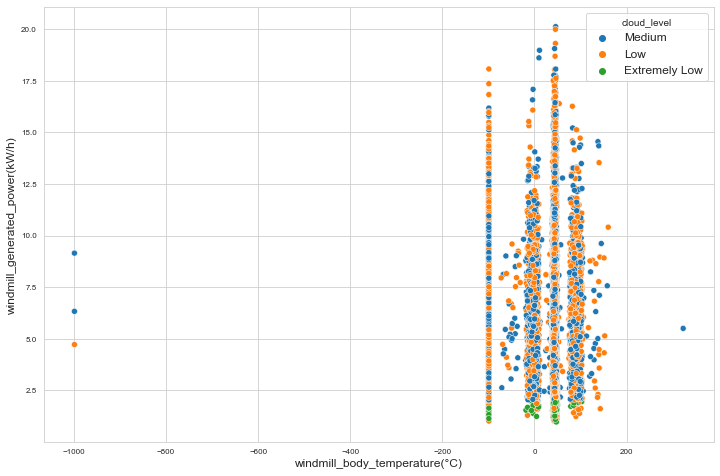

In [89]:
sns.scatterplot(x='windmill_body_temperature(°C)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__wind_direction(°)__

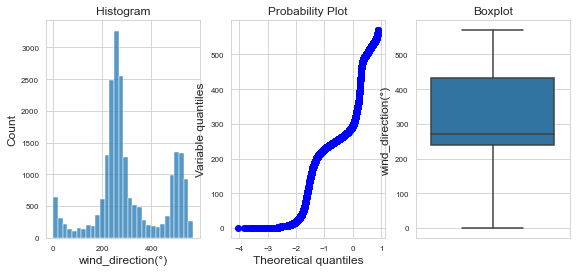

In [90]:
diagnostic_plots(df, 'wind_direction(°)')

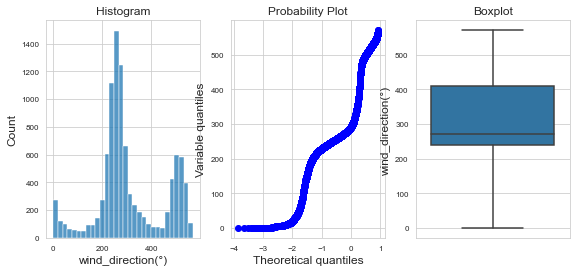

In [91]:
diagnostic_plots(df_test, 'wind_direction(°)')

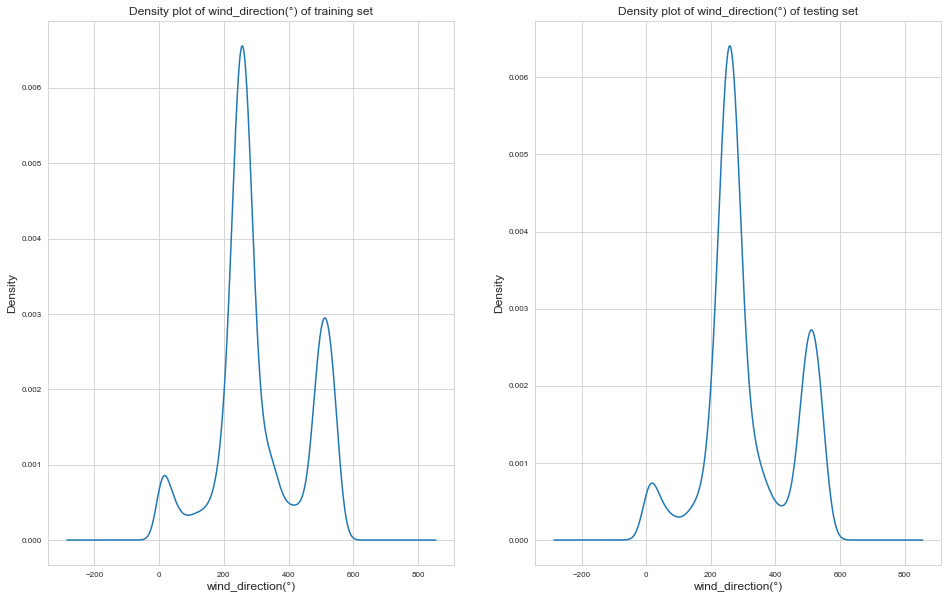

In [92]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'wind_direction(°)')
## Distribution of Feature "wind_direction(°)" of training and testing dataset is almost same

<AxesSubplot:xlabel='wind_direction(°)', ylabel='windmill_generated_power(kW/h)'>

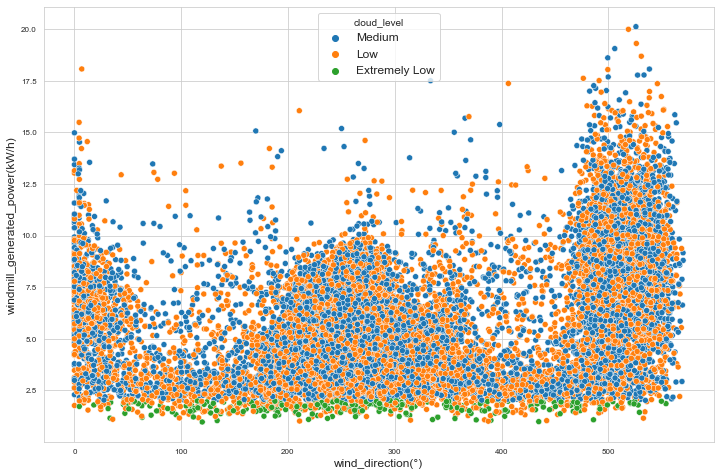

In [93]:
sns.scatterplot(x='wind_direction(°)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__resistance(ohm)__

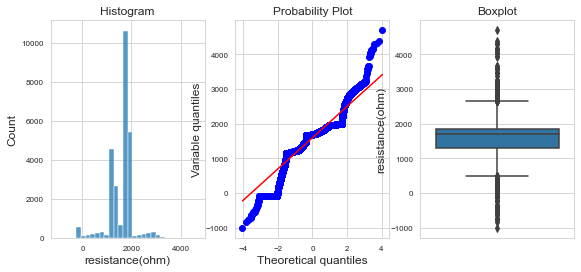

In [94]:
diagnostic_plots(df, 'resistance(ohm)')

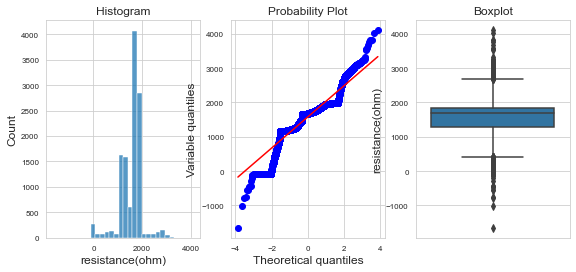

In [95]:
diagnostic_plots(df_test, 'resistance(ohm)')

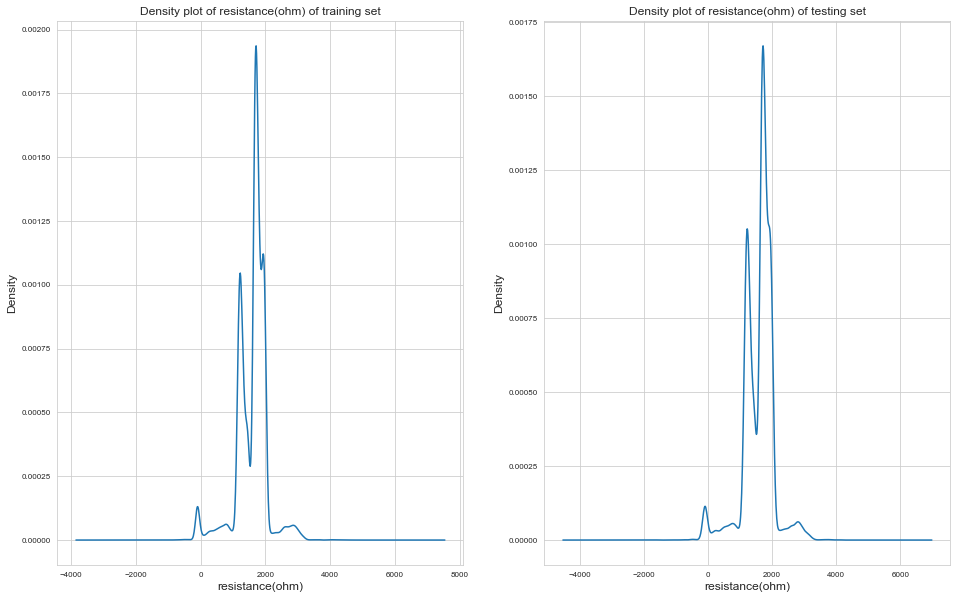

In [96]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'resistance(ohm)')
## Distribution of Feature "resistance(ohm)" of training and testing dataset is almost same

<AxesSubplot:xlabel='resistance(ohm)', ylabel='windmill_generated_power(kW/h)'>

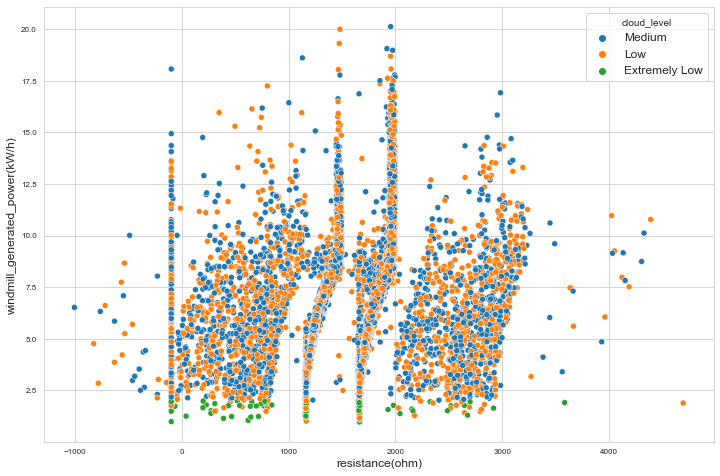

In [97]:
sns.scatterplot(x='resistance(ohm)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__rotor_torque(N-m)__

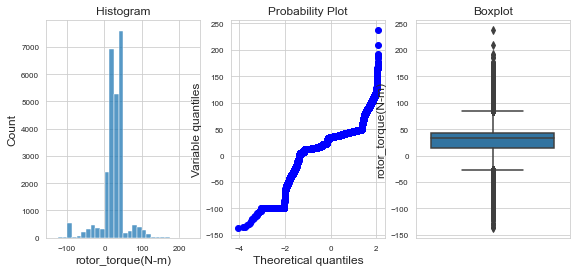

In [98]:
diagnostic_plots(df, 'rotor_torque(N-m)')

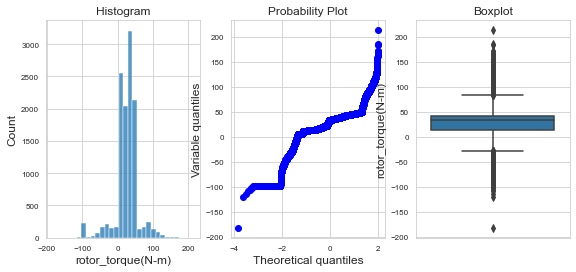

In [99]:
diagnostic_plots(df_test, 'rotor_torque(N-m)')

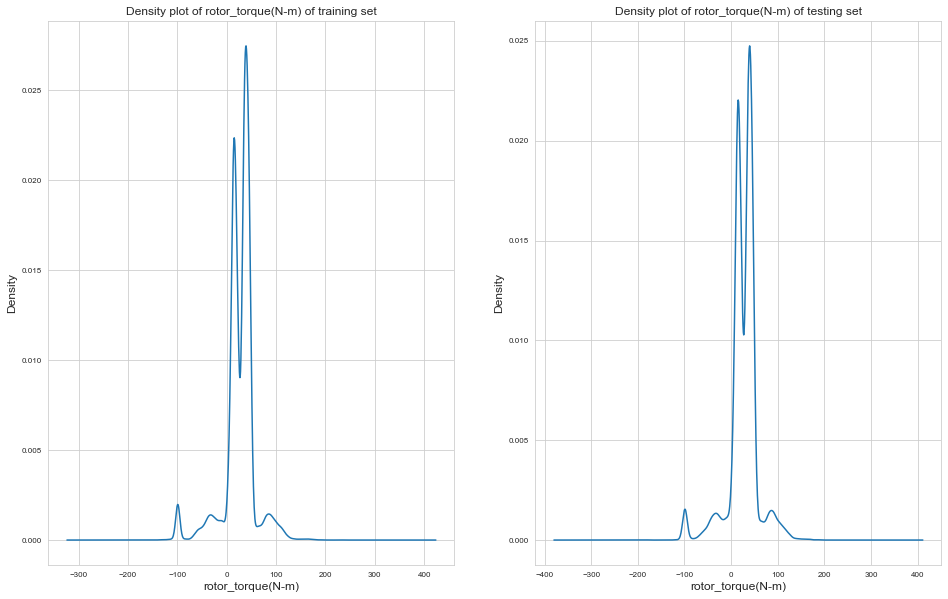

In [100]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'rotor_torque(N-m)')
## Distribution of Feature "rotor_torque(N-m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='rotor_torque(N-m)', ylabel='windmill_generated_power(kW/h)'>

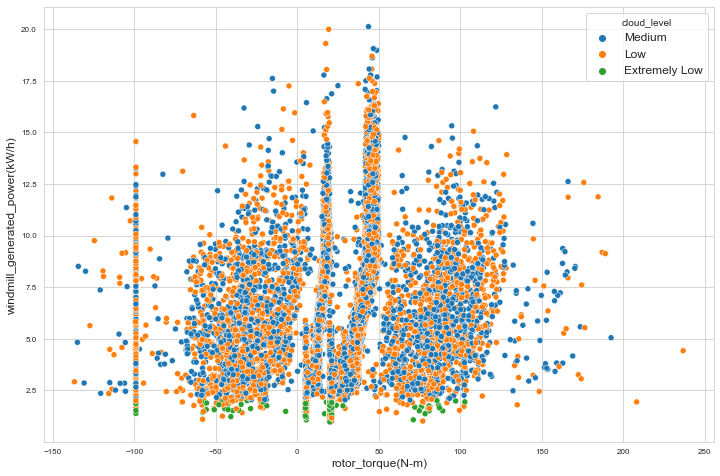

In [101]:
sns.scatterplot(x='rotor_torque(N-m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__blade_length(m)__

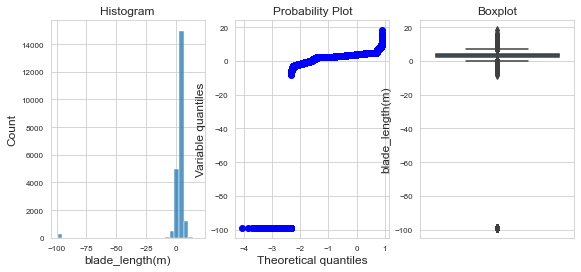

In [102]:
diagnostic_plots(df, 'blade_length(m)')

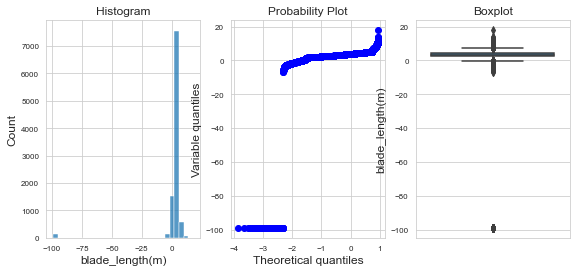

In [103]:
diagnostic_plots(df_test, 'blade_length(m)')

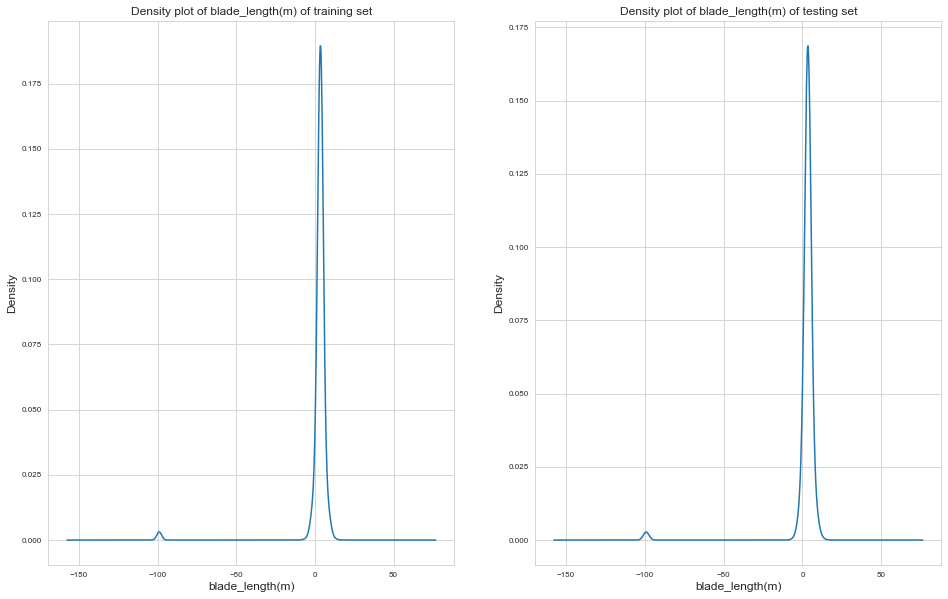

In [104]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blade_length(m)')
## Distribution of Feature "blade_length(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='blade_length(m)', ylabel='windmill_generated_power(kW/h)'>

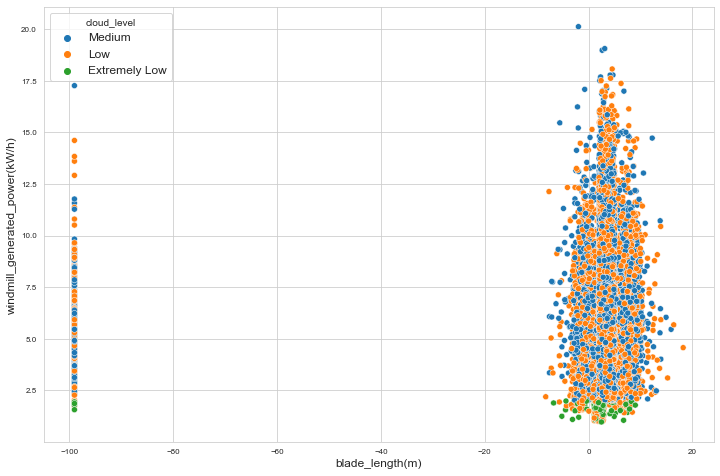

In [105]:
sns.scatterplot(x='blade_length(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [106]:
## Removing extreme outliers

low = df['blade_length(m)'] < -20
low = np.where(low)
df.drop(low[0],inplace=True)
df.index = range(df.shape[0])

<AxesSubplot:xlabel='blade_length(m)', ylabel='windmill_generated_power(kW/h)'>

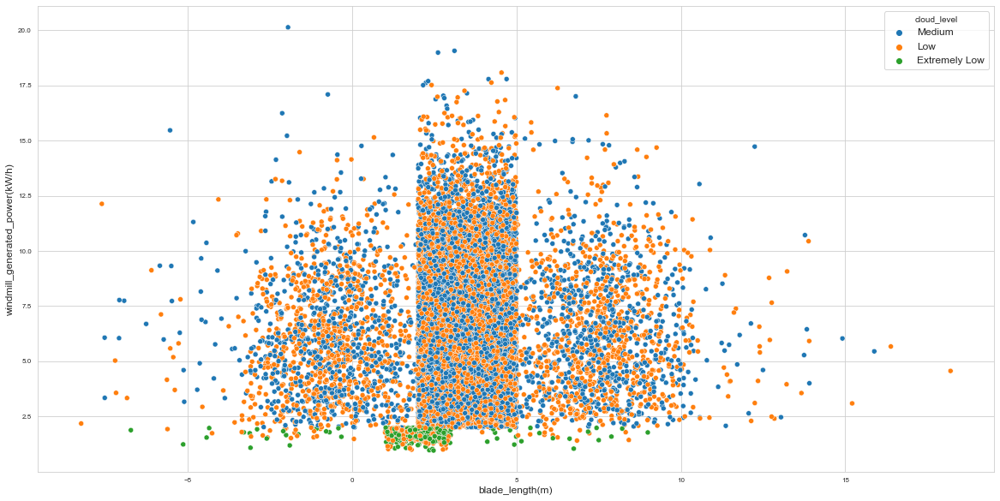

In [107]:
plt.figure(figsize=(20,10))
sns.scatterplot(x='blade_length(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

__blade_breadth(m)__

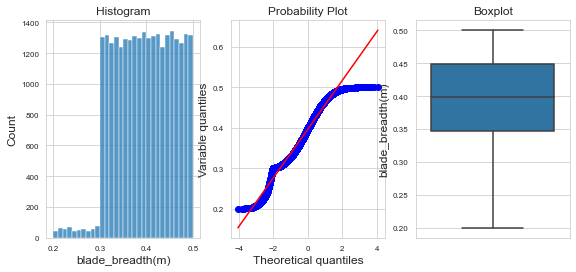

In [108]:
diagnostic_plots(df, 'blade_breadth(m)')

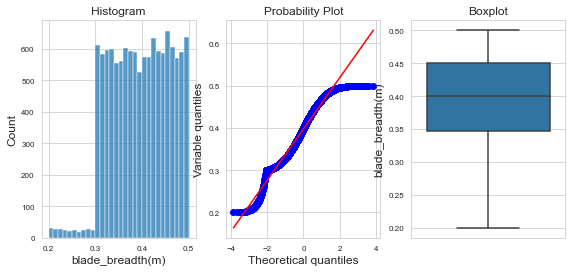

In [109]:
diagnostic_plots(df_test, 'blade_breadth(m)')

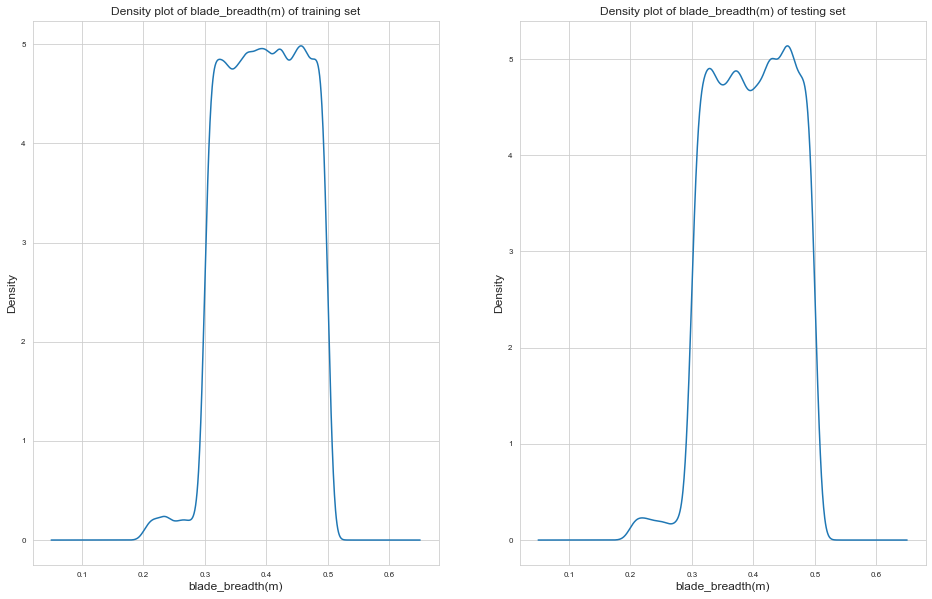

In [110]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'blade_breadth(m)')
## Distribution of Feature "blade_breadth(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='blade_breadth(m)', ylabel='windmill_generated_power(kW/h)'>

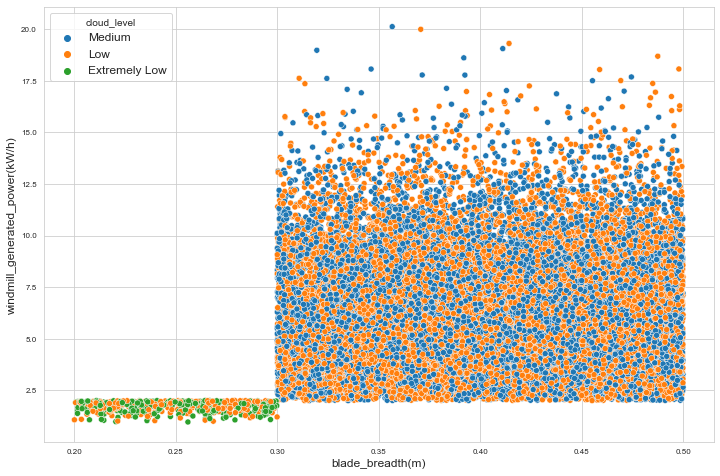

In [111]:
sns.scatterplot(x='blade_breadth(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

From the above density plot of feature "blade_breadth(m)", we found that the distribution of "blade_breadth(m)" is almost same in training and testing dataset, so we are not changing anything in it.

__windmill_height(m)__

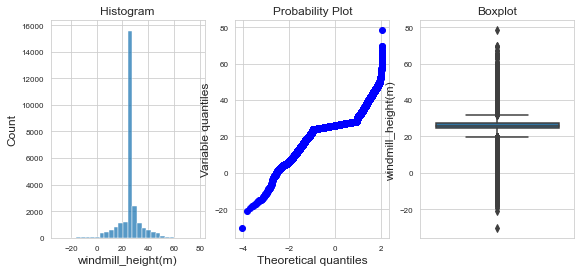

In [112]:
diagnostic_plots(df, 'windmill_height(m)')

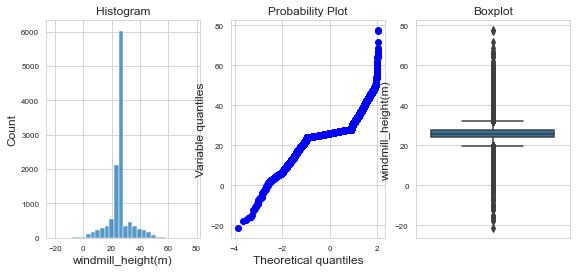

In [113]:
diagnostic_plots(df_test, 'windmill_height(m)')

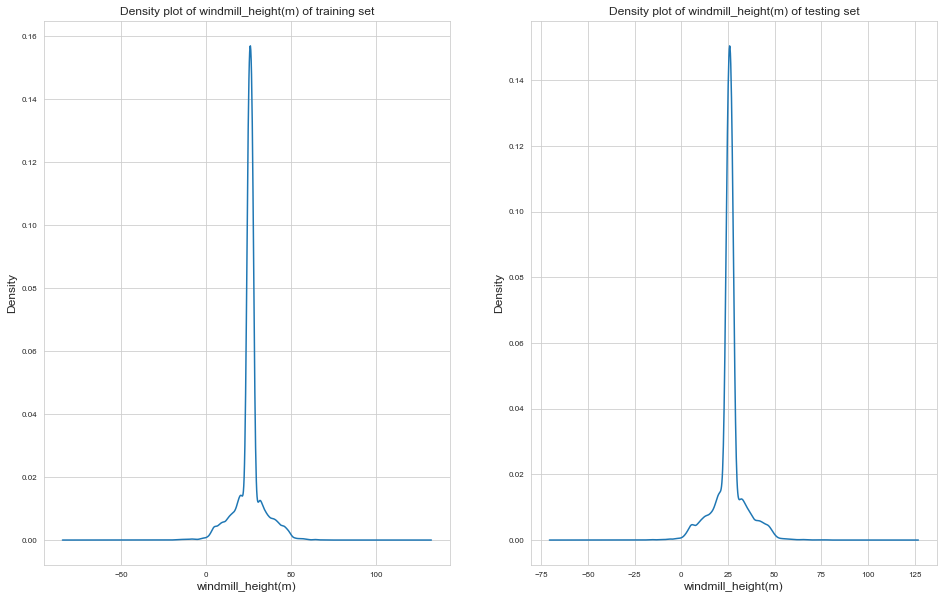

In [114]:
## Comparing the density plot of features in training and testing set
comparing_train_and_test_feature(df,df_test,'windmill_height(m)')
## Distribution of Feature "windmill_height(m)" of training and testing dataset is almost same

<AxesSubplot:xlabel='windmill_height(m)', ylabel='windmill_generated_power(kW/h)'>

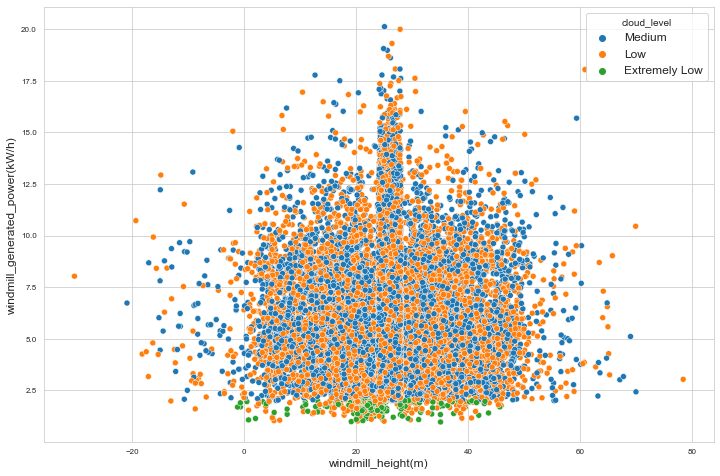

In [115]:
sns.scatterplot(x='windmill_height(m)',y='windmill_generated_power(kW/h)',hue='cloud_level',data=df)

In [116]:
def fillNan(df, col, value):
    df[col].fillna(value, inplace=True)

In [117]:
fillNan(df, 'atmospheric_pressure(Pascal)', df['atmospheric_pressure(Pascal)'].mean())
fillNan(df_test, 'atmospheric_pressure(Pascal)', df['atmospheric_pressure(Pascal)'].mean())
df['atmospheric_pressure(Pascal)'].isna().any()

False

In [118]:
fillNan(df, 'motor_torque(N-m)', df['motor_torque(N-m)'].mean())
fillNan(df_test, 'motor_torque(N-m)', df['motor_torque(N-m)'].mean())
df['motor_torque(N-m)'].isna().any()

False

In [119]:
fillNan(df, 'wind_speed(m/s)', df['wind_speed(m/s)'].mean())
fillNan(df_test, 'wind_speed(m/s)', df['wind_speed(m/s)'].mean())
df['wind_speed(m/s)'].isna().any()

False

In [120]:
fillNan(df, 'windmill_height(m)', df['windmill_height(m)'].mean())
fillNan(df_test, 'windmill_height(m)', df['windmill_height(m)'].mean())
df['windmill_height(m)'].isna().any()

False

In [121]:
fillNan(df, 'wind_direction(°)', df['wind_direction(°)'].mean())
fillNan(df_test, 'wind_direction(°)', df['wind_direction(°)'].mean())
df['wind_direction(°)'].isna().any()

False

In [122]:
fillNan(df, 'generator_temperature(°C)', df['generator_temperature(°C)'].mean())
fillNan(df_test, 'generator_temperature(°C)', df['generator_temperature(°C)'].mean())
df['generator_temperature(°C)'].isna().any()

False

In [123]:
fillNan(df, "blade_breadth(m)", df["blade_breadth(m)"].mean())
fillNan(df_test, "blade_breadth(m)", df["blade_breadth(m)"].mean())
df["blade_breadth(m)"].isna().any()

False

In [124]:
fillNan(df, 'blade_length(m)', df['blade_length(m)'].mean())
fillNan(df_test, 'blade_length(m)', df['blade_length(m)'].mean())
df['blade_length(m)'].isna().any()

False

In [125]:
fillNan(df, 'atmospheric_temperature(°C)', df['atmospheric_temperature(°C)'].mean())
fillNan(df_test, 'atmospheric_temperature(°C)', df['atmospheric_temperature(°C)'].mean())
df['atmospheric_temperature(°C)'].isna().any()

False

In [126]:
fillNan(df, 'windmill_body_temperature(°C)', df['windmill_body_temperature(°C)'].mean())
fillNan(df_test, 'windmill_body_temperature(°C)', df['windmill_body_temperature(°C)'].mean())
df['windmill_body_temperature(°C)'].isna().any()

False

In [127]:
fillNan(df, 'blades_angle(°)', df['blades_angle(°)'].mean())
fillNan(df_test, 'blades_angle(°)', df['blades_angle(°)'].mean())
df['blades_angle(°)'].isna().any()

False

In [128]:
fillNan(df, 'engine_temperature(°C)', df['engine_temperature(°C)'].mean())
fillNan(df_test, 'engine_temperature(°C)', df['engine_temperature(°C)'].mean())
df['engine_temperature(°C)'].isna().any()

False

In [129]:
fillNan(df, 'shaft_temperature(°C)', df['shaft_temperature(°C)'].mean())
fillNan(df_test, 'shaft_temperature(°C)', df['shaft_temperature(°C)'].mean())
df['shaft_temperature(°C)'].isna().any()

False

In [130]:
fillNan(df, 'gearbox_temperature(°C)', df['gearbox_temperature(°C)'].mean())
fillNan(df_test, 'gearbox_temperature(°C)', df['gearbox_temperature(°C)'].mean())
df['gearbox_temperature(°C)'].isna().any()

False

In [131]:
fillNan(df, 'resistance(ohm)', df['resistance(ohm)'].mean())
fillNan(df_test, 'resistance(ohm)', df['resistance(ohm)'].mean())
df['resistance(ohm)'].isna().any()

False

In [132]:
fillNan(df, 'rotor_torque(N-m)', df['rotor_torque(N-m)'].mean())
fillNan(df_test, 'resistance(ohm)', df['rotor_torque(N-m)'].mean())
df['rotor_torque(N-m)'].isna().any()

False

In [133]:
fillNan(df, 'turbine_status', df['turbine_status'].mode()[0])
fillNan(df_test, 'turbine_status', df['turbine_status'].mode()[0])
df['turbine_status'].isna().any()

False

In [134]:
fillNan(df, 'cloud_level', df['cloud_level'].mode()[0])
fillNan(df_test, 'cloud_level', df['cloud_level'].mode()[0])
df['cloud_level'].isna().any()

False

In [135]:
fillNan(df, 'windmill_generated_power(kW/h)', df['windmill_generated_power(kW/h)'].median())
df['windmill_generated_power(kW/h)'].isna().any()

False

## Create Dummy Features

In [136]:
cont_features, cat_features = divideFeatures(df)
cat_features

,tracking_id,datetime,turbine_status,cloud_level
0,WM_33725,2019-08-04 14:33:20,BA,Medium
1,WM_698,2018-11-05 10:13:20,A2,Medium
2,WM_39146,2019-09-14 14:03:20,ABC,Medium
3,WM_6757,2018-12-25 15:33:20,ABC,Low
4,WM_21521,2019-05-04 03:13:20,AAA,Medium
...,...,...,...,...
26556,WM_7814,2019-01-02 02:43:20,BB,Medium
26557,WM_32512,2019-07-26 12:53:20,BB,Low
26558,WM_5193,2018-12-12 02:13:20,D,Medium
26559,WM_12173,2019-02-03 19:13:20,BCB,Low


In [137]:
# label encoding
def mapFeature(data, f, data_test=None):
    feat = data[f].unique()
    feat_idx = [x for x in range(len(feat))]

    data[f].replace(feat, feat_idx, inplace=True)
    if data_test is not None:
        data_test[f].replace(feat, feat_idx, inplace=True)

In [138]:
for col in cat_features.columns[2:]:
    mapFeature(df, col, df_test)
df_test.head()

,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),turbine_status,cloud_level,blade_length(m),blade_breadth(m),windmill_height(m)
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,0,0,3.19,0.40,25.57
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,50885.00,29.43,42.73,499.60,1165.11,-35.05,12,0,3.02,0.44,24.37
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,10,0,2.61,0.39,27.65
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,50885.00,23.89,13.50,308.73,1329.74,15.25,11,1,2.87,0.45,24.19
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,12,1,3.55,0.37,4.89


In [139]:
# create dummy features
custom_feat = ['turbine_status']
for feat in cat_features.columns:
    if len(df[feat].unique()) > 2 and feat in custom_feat:
        dummyVars = pd.get_dummies(df[feat], drop_first=True, prefix=feat+"_")
        df = pd.concat([df, dummyVars], axis=1)
        df.drop(feat, axis=1, inplace=True)
datasetShape(df)

df.head()

The dataframe has 26561 rows and 34 columns.


,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13
0,WM_33725,2019-08-04 14:33:20,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,21.88,239.84,2730.31,42.08,0,2.22,0.31,24.28,6.77,0,0,0,0,0,0,0,0,0,0,0,0,0
1,WM_698,2018-11-05 10:13:20,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,21.88,337.94,1780.21,107.89,0,4.21,0.45,27.26,5.97,1,0,0,0,0,0,0,0,0,0,0,0,0
2,WM_39146,2019-09-14 14:03:20,95.48,0.83,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,0,2.72,0.30,27.37,2.87,0,1,0,0,0,0,0,0,0,0,0,0,0
3,WM_6757,2018-12-25 15:33:20,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,1,4.86,0.37,24.29,14.85,0,1,0,0,0,0,0,0,0,0,0,0,0
4,WM_21521,2019-05-04 03:13:20,10.72,0.83,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,0,3.47,0.45,27.97,3.52,0,0,1,0,0,0,0,0,0,0,0,0,0


In [140]:
# create dummy features
custom_feat = ['turbine_status']
for feat in cat_features.columns:
    if len(df_test[feat].unique()) > 2 and feat in custom_feat:
        dummyVars = pd.get_dummies(df_test[feat], drop_first=True, prefix=feat+"_")
        df_test = pd.concat([df_test, dummyVars], axis=1)
        df_test.drop(feat, axis=1, inplace=True)
datasetShape(df_test)

df_test.head()

The dataframe has 12086 rows and 33 columns.


,tracking_id,datetime,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13
0,WM_19817,2019-04-17 08:53:20,94.32,17.64,89.71,51.15,40.46,39.59,1073.20,66.83,16681.04,24.00,43.76,445.98,1664.22,21.91,0,3.19,0.40,25.57,0,0,0,0,0,0,0,0,0,0,0,0,0
1,WM_18723,2019-03-30 07:43:20,10.09,13.98,43.27,46.52,40.03,41.18,517.44,37.28,50885.00,29.43,42.73,499.60,1165.11,-35.05,0,3.02,0.44,24.37,0,0,0,0,0,0,0,0,0,0,0,1,0
2,WM_34552,2019-08-10 11:33:20,347.15,31.42,41.08,26.93,43.11,43.44,1480.72,70.01,214812.84,29.92,43.26,245.43,1667.72,27.20,0,2.61,0.39,27.65,0,0,0,0,0,0,0,0,0,1,0,0,0
3,WM_28570,2019-06-26 03:53:20,24.47,-99.00,14.38,66.51,13.74,15.58,887.98,41.45,50885.00,23.89,13.50,308.73,1329.74,15.25,1,2.87,0.45,24.19,0,0,0,0,0,0,0,0,0,0,1,0,0
4,WM_36934,2019-08-27 16:43:20,97.00,33.28,41.41,1.84,121.57,43.93,2053.92,68.01,16833.55,35.91,-99.00,442.43,691.41,34.26,1,3.55,0.37,4.89,0,0,0,0,0,0,0,0,0,0,0,1,0


In [141]:
# ## Feature "cloud_level" is categorical with 3 unique values
# df['cloud_level'].replace(['Medium', 'Low', 'Extremely Low'],[2,1,0],inplace=True)
# df_test['cloud_level'].replace(['Medium', 'Low', 'Extremely Low'],[2,1,0],inplace=True)

## Derive Features

In [142]:
df['datetime'] = pd.to_datetime(df['datetime'])
df_test['datetime'] = pd.to_datetime(df_test['datetime'])

df['year'] = df['datetime'].dt.year
df_test['year'] = df_test['datetime'].dt.year

df['month'] = df['datetime'].dt.month
df_test['month'] = df_test['datetime'].dt.month

df['day'] = df['datetime'].dt.day
df_test['day'] = df_test['datetime'].dt.day

df['dayofweek'] = df['datetime'].dt.dayofweek
df_test['dayofweek'] = df_test['datetime'].dt.dayofweek

df['quarter'] = df['datetime'].dt.quarter
df_test['quarter'] = df_test['datetime'].dt.quarter

df['hour'] = df['datetime'].dt.hour
df['min'] = df['datetime'].dt.minute
df['sec'] = df['datetime'].dt.second

df_test['hour'] = df_test['datetime'].dt.hour
df_test['min'] = df_test['datetime'].dt.minute
df_test['sec'] = df_test['datetime'].dt.second

In [143]:
df.drop(['tracking_id', 'datetime'], inplace=True, axis=1)
submission = pd.DataFrame(data=df_test['tracking_id'])
submission['datetime'] = df_test.datetime
df_test.drop(['tracking_id', 'datetime'], inplace=True, axis=1)
df.head()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),windmill_generated_power(kW/h),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13,year,month,day,dayofweek,quarter,hour,min,sec
0,94.82,-99.00,41.72,-0.90,82.41,42.52,2563.12,76.67,103402.96,26.90,21.88,239.84,2730.31,42.08,0,2.22,0.31,24.28,6.77,0,0,0,0,0,0,0,0,0,0,0,0,0,2019,8,4,6,3,14,33,20
1,241.83,27.76,-99.00,-99.00,44.10,46.26,2372.38,78.13,17030.90,39.80,21.88,337.94,1780.21,107.89,0,4.21,0.45,27.26,5.97,1,0,0,0,0,0,0,0,0,0,0,0,0,2018,11,5,0,4,10,13,20
2,95.48,0.83,41.86,12.65,42.32,42.88,1657.17,67.65,16125.93,36.12,45.03,227.85,1666.05,-42.93,0,2.72,0.30,27.37,2.87,0,1,0,0,0,0,0,0,0,0,0,0,0,2019,9,14,5,3,14,3,20
3,238.82,-99.00,45.44,15.12,44.76,47.28,2888.13,95.39,18689.73,46.02,44.83,492.08,1964.50,42.74,1,4.86,0.37,24.29,14.85,0,1,0,0,0,0,0,0,0,0,0,0,0,2018,12,25,1,4,15,33,20
4,10.72,0.83,41.98,1.72,-17.62,43.47,781.70,37.42,114468.17,34.57,-99.00,259.27,1177.52,13.39,0,3.47,0.45,27.97,3.52,0,0,1,0,0,0,0,0,0,0,0,0,0,2019,5,4,5,2,3,13,20


## Data Modeling

In [144]:
# shuffle samples
df_shuffle = df.sample(frac=1, random_state=42).reset_index(drop=True)

df_y = df_shuffle.pop(targetFeature)
df_X = df_shuffle

# split into train dev and test
X_train, X_test, y_train, y_test = train_test_split(df_X, df_y, train_size=0.8, random_state=42)
print(f"Train set has {X_train.shape[0]} records out of {len(df_shuffle)} which is {round(X_train.shape[0]/len(df_shuffle)*100)}%")
print(f"Test set has {X_test.shape[0]} records out of {len(df_shuffle)} which is {round(X_test.shape[0]/len(df_shuffle)*100)}%")

Train set has 21248 records out of 26561 which is 80%
Test set has 5313 records out of 26561 which is 20%


In [145]:
scaler = RobustScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)

# scale test data with transform()
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_train.columns)

# view sample data
X_train.describe()

,wind_speed(m/s),atmospheric_temperature(°C),shaft_temperature(°C),blades_angle(°),gearbox_temperature(°C),engine_temperature(°C),motor_torque(N-m),generator_temperature(°C),atmospheric_pressure(Pascal),area_temperature(°C),windmill_body_temperature(°C),wind_direction(°),resistance(ohm),rotor_torque(N-m),cloud_level,blade_length(m),blade_breadth(m),windmill_height(m),turbine_status__1,turbine_status__2,turbine_status__3,turbine_status__4,turbine_status__5,turbine_status__6,turbine_status__7,turbine_status__8,turbine_status__9,turbine_status__10,turbine_status__11,turbine_status__12,turbine_status__13,year,month,day,dayofweek,quarter,hour,min,sec
count,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00,21248.00
mean,-0.31,-0.63,-0.72,-1.57,-0.28,0.05,-0.19,-0.14,0.33,0.02,-0.91,0.16,-0.17,-0.25,-0.48,0.01,-0.01,-0.01,0.07,0.07,0.13,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,0.07,-0.20,0.04,-0.03,-0.02,0.19,-0.02,-0.17,0.00
std,1.07,1.89,7.10,7.37,8.44,0.71,0.51,0.53,1.80,0.66,2.30,1.29,0.88,1.18,0.52,1.24,0.60,2.59,0.25,0.25,0.34,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.25,0.40,0.59,0.58,0.50,0.55,0.58,0.57,0.00
min,-7.02,-5.16,-37.69,-22.93,-47.73,-1.82,-0.98,-1.01,-12.18,-2.11,-46.29,-3.07,-4.93,-6.25,-1.00,-8.32,-1.94,-15.75,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-1.00,-0.83,-1.00,-0.75,-0.50,-1.00,-1.00,0.00
25%,-0.97,-0.63,-0.49,-0.11,-0.49,-0.48,-0.72,-0.78,-0.02,-0.49,-0.92,-0.49,-0.72,-0.70,-1.00,-0.50,-0.50,-0.48,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.50,-0.53,-0.50,-0.50,-0.50,-0.67,0.00
50%,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
75%,0.03,0.37,0.51,0.89,0.51,0.52,0.28,0.22,0.98,0.51,0.08,0.51,0.28,0.30,0.00,0.50,0.50,0.52,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.47,0.50,0.50,0.50,0.33,0.00
max,7.19,2.97,33.26,26.19,48.65,2.06,0.59,0.78,12.65,2.06,5.23,2.90,5.51,7.47,1.00,10.45,1.00,17.64,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00,0.75,1.00,0.92,0.67,0.00


### XGBoost Regressor

In [147]:
regressor1 = XGBRegressor(n_estimators=500,max_depth=5,booster='gbtree',n_jobs=-1,learning_rate=0.1,reg_lambda=0.01,reg_alpha=0.3)
regressor1.fit(X_train, y_train)

# predict
y_train_pred = regressor1.predict(X_train)
y_test_pred = regressor1.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

0.9892151932671821
0.9643053860043503


### LGBM Regressor

In [148]:
regressor2 = lgb.LGBMRegressor(objective='mse', seed=8798, num_threads=1, learning_rate=0.1, 
                               max_depth=5, n_estimators=750, num_leaves=70, reg_alpha=0.001, reg_lambda=0.003)
regressor2.fit(X_train, y_train, verbose=10)

y_train_pred = regressor2.predict(X_train)
y_test_pred = regressor2.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1
0.9887361576488731
0.962724561893846


### CatBoost Regressor

In [149]:
regressor3 = CatBoostRegressor()
regressor3.fit(X_train, y_train)

y_train_pred = regressor3.predict(X_train)
y_test_pred = regressor3.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

Learning rate set to 0.067246
0:	learn: 2.5812114	total: 190ms	remaining: 3m 10s
1:	learn: 2.4467144	total: 210ms	remaining: 1m 44s
2:	learn: 2.3275130	total: 230ms	remaining: 1m 16s
3:	learn: 2.2215765	total: 245ms	remaining: 1m 1s
4:	learn: 2.1273666	total: 255ms	remaining: 50.7s
5:	learn: 2.0309433	total: 266ms	remaining: 44s
6:	learn: 1.9468033	total: 276ms	remaining: 39.1s
7:	learn: 1.8568960	total: 286ms	remaining: 35.4s
8:	learn: 1.7748845	total: 296ms	remaining: 32.6s
9:	learn: 1.7110640	total: 306ms	remaining: 30.2s
10:	learn: 1.6443668	total: 315ms	remaining: 28.3s
11:	learn: 1.5817451	total: 325ms	remaining: 26.8s
12:	learn: 1.5205301	total: 335ms	remaining: 25.5s
13:	learn: 1.4594748	total: 346ms	remaining: 24.4s
14:	learn: 1.4053586	total: 356ms	remaining: 23.4s
15:	learn: 1.3507310	total: 364ms	remaining: 22.4s
16:	learn: 1.3051053	total: 370ms	remaining: 21.4s
17:	learn: 1.2573351	total: 377ms	remaining: 20.5s
18:	learn: 1.2257560	total: 383ms	remaining: 19.8s
19:	learn:

165:	learn: 0.5689227	total: 1.25s	remaining: 6.31s
166:	learn: 0.5682657	total: 1.26s	remaining: 6.3s
167:	learn: 0.5678981	total: 1.27s	remaining: 6.28s
168:	learn: 0.5672518	total: 1.27s	remaining: 6.27s
169:	learn: 0.5665669	total: 1.28s	remaining: 6.25s
170:	learn: 0.5661196	total: 1.29s	remaining: 6.23s
171:	learn: 0.5658457	total: 1.29s	remaining: 6.21s
172:	learn: 0.5649949	total: 1.3s	remaining: 6.2s
173:	learn: 0.5646296	total: 1.3s	remaining: 6.18s
174:	learn: 0.5640798	total: 1.31s	remaining: 6.17s
175:	learn: 0.5632146	total: 1.31s	remaining: 6.15s
176:	learn: 0.5622357	total: 1.32s	remaining: 6.14s
177:	learn: 0.5618227	total: 1.32s	remaining: 6.12s
178:	learn: 0.5611293	total: 1.33s	remaining: 6.11s
179:	learn: 0.5605705	total: 1.34s	remaining: 6.09s
180:	learn: 0.5596788	total: 1.34s	remaining: 6.07s
181:	learn: 0.5584788	total: 1.35s	remaining: 6.06s
182:	learn: 0.5580079	total: 1.35s	remaining: 6.04s
183:	learn: 0.5575638	total: 1.36s	remaining: 6.03s
184:	learn: 0.55

335:	learn: 0.4939655	total: 2.3s	remaining: 4.54s
336:	learn: 0.4937300	total: 2.31s	remaining: 4.54s
337:	learn: 0.4933321	total: 2.31s	remaining: 4.53s
338:	learn: 0.4929557	total: 2.32s	remaining: 4.52s
339:	learn: 0.4928265	total: 2.32s	remaining: 4.51s
340:	learn: 0.4924936	total: 2.33s	remaining: 4.5s
341:	learn: 0.4922572	total: 2.33s	remaining: 4.49s
342:	learn: 0.4918887	total: 2.34s	remaining: 4.48s
343:	learn: 0.4916376	total: 2.35s	remaining: 4.47s
344:	learn: 0.4915062	total: 2.35s	remaining: 4.46s
345:	learn: 0.4912768	total: 2.36s	remaining: 4.45s
346:	learn: 0.4908867	total: 2.36s	remaining: 4.45s
347:	learn: 0.4904655	total: 2.37s	remaining: 4.44s
348:	learn: 0.4899827	total: 2.37s	remaining: 4.43s
349:	learn: 0.4895931	total: 2.38s	remaining: 4.42s
350:	learn: 0.4894213	total: 2.38s	remaining: 4.41s
351:	learn: 0.4891289	total: 2.39s	remaining: 4.4s
352:	learn: 0.4888156	total: 2.4s	remaining: 4.39s
353:	learn: 0.4884850	total: 2.4s	remaining: 4.38s
354:	learn: 0.488

513:	learn: 0.4512292	total: 3.35s	remaining: 3.17s
514:	learn: 0.4509673	total: 3.35s	remaining: 3.16s
515:	learn: 0.4507778	total: 3.36s	remaining: 3.15s
516:	learn: 0.4505489	total: 3.36s	remaining: 3.14s
517:	learn: 0.4503901	total: 3.37s	remaining: 3.14s
518:	learn: 0.4501169	total: 3.38s	remaining: 3.13s
519:	learn: 0.4499595	total: 3.38s	remaining: 3.12s
520:	learn: 0.4497531	total: 3.39s	remaining: 3.11s
521:	learn: 0.4496738	total: 3.39s	remaining: 3.11s
522:	learn: 0.4494456	total: 3.4s	remaining: 3.1s
523:	learn: 0.4491531	total: 3.4s	remaining: 3.09s
524:	learn: 0.4489485	total: 3.41s	remaining: 3.08s
525:	learn: 0.4488745	total: 3.42s	remaining: 3.08s
526:	learn: 0.4486908	total: 3.42s	remaining: 3.07s
527:	learn: 0.4484952	total: 3.43s	remaining: 3.06s
528:	learn: 0.4483222	total: 3.43s	remaining: 3.06s
529:	learn: 0.4480539	total: 3.44s	remaining: 3.05s
530:	learn: 0.4477678	total: 3.44s	remaining: 3.04s
531:	learn: 0.4475927	total: 3.45s	remaining: 3.03s
532:	learn: 0.4

688:	learn: 0.4197750	total: 4.39s	remaining: 1.98s
689:	learn: 0.4195892	total: 4.4s	remaining: 1.98s
690:	learn: 0.4194268	total: 4.41s	remaining: 1.97s
691:	learn: 0.4192545	total: 4.41s	remaining: 1.96s
692:	learn: 0.4191175	total: 4.42s	remaining: 1.96s
693:	learn: 0.4189303	total: 4.42s	remaining: 1.95s
694:	learn: 0.4188269	total: 4.43s	remaining: 1.94s
695:	learn: 0.4186416	total: 4.44s	remaining: 1.94s
696:	learn: 0.4184954	total: 4.44s	remaining: 1.93s
697:	learn: 0.4183000	total: 4.45s	remaining: 1.93s
698:	learn: 0.4181955	total: 4.46s	remaining: 1.92s
699:	learn: 0.4180763	total: 4.46s	remaining: 1.91s
700:	learn: 0.4177589	total: 4.47s	remaining: 1.91s
701:	learn: 0.4175743	total: 4.47s	remaining: 1.9s
702:	learn: 0.4174781	total: 4.48s	remaining: 1.89s
703:	learn: 0.4173313	total: 4.49s	remaining: 1.89s
704:	learn: 0.4172264	total: 4.49s	remaining: 1.88s
705:	learn: 0.4171685	total: 4.5s	remaining: 1.87s
706:	learn: 0.4169108	total: 4.5s	remaining: 1.87s
707:	learn: 0.41

849:	learn: 0.3967296	total: 5.45s	remaining: 961ms
850:	learn: 0.3965974	total: 5.45s	remaining: 955ms
851:	learn: 0.3964420	total: 5.46s	remaining: 949ms
852:	learn: 0.3963199	total: 5.47s	remaining: 942ms
853:	learn: 0.3960583	total: 5.47s	remaining: 936ms
854:	learn: 0.3958457	total: 5.48s	remaining: 929ms
855:	learn: 0.3957295	total: 5.49s	remaining: 923ms
856:	learn: 0.3955760	total: 5.49s	remaining: 916ms
857:	learn: 0.3954045	total: 5.5s	remaining: 910ms
858:	learn: 0.3952871	total: 5.5s	remaining: 904ms
859:	learn: 0.3951663	total: 5.51s	remaining: 897ms
860:	learn: 0.3950338	total: 5.52s	remaining: 891ms
861:	learn: 0.3947474	total: 5.52s	remaining: 884ms
862:	learn: 0.3945762	total: 5.53s	remaining: 878ms
863:	learn: 0.3944572	total: 5.54s	remaining: 871ms
864:	learn: 0.3943168	total: 5.54s	remaining: 865ms
865:	learn: 0.3941864	total: 5.55s	remaining: 859ms
866:	learn: 0.3940741	total: 5.55s	remaining: 852ms
867:	learn: 0.3937675	total: 5.56s	remaining: 846ms
868:	learn: 0.

### DecisionTree Regressor

In [ ]:
# regressor4 = DecisionTreeRegressor(max_depth=100, min_samples_split=45, min_samples_leaf=10)
# regressor4.fit(X_train, y_train)

# y_train_pred = regressor4.predict(X_train)
# y_test_pred = regressor4.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### ExtraTree Regressor

In [ ]:
# regressor5 = ExtraTreeRegressor()
# regressor5.fit(X_train, y_train)

# y_train_pred = regressor5.predict(X_train)
# y_test_pred = regressor5.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### RandomForest Regressor

In [ ]:
# regressor6 = RandomForestRegressor(n_estimators=500, min_samples_leaf=1, max_depth=20, 
#                                 min_samples_split=3)
# regressor6.fit(X_train, y_train)

# y_train_pred = regressor6.predict(X_train)
# y_test_pred = regressor6.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### AdaBoost Regressor

In [ ]:
# regressor7 = AdaBoostRegressor()
# regressor7.fit(X_train, y_train)

# y_train_pred = regressor7.predict(X_train)
# y_test_pred = regressor7.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### ExtraTrees Regressor

In [ ]:
# regressor8 = ExtraTreesRegressor(criterion='mse', random_state=0, n_jobs=-1, 
#                                 min_samples_leaf=1, max_depth=20, 
#                                 min_samples_split=3, n_estimators=1000)
# regressor8.fit(X_train, y_train)
# y_train_pred = regressor8.predict(X_train)
# y_test_pred = regressor8.predict(X_test)
# print(r2_score(y_train,y_train_pred))
# print(r2_score(y_test,y_test_pred))

### GradientBoosting Regressor

In [151]:
regressor4 = GradientBoostingRegressor(criterion='mse',random_state=0,max_depth=5,
                                     n_estimators=500,min_samples_split=2,min_samples_leaf=2)
regressor4.fit(X_train, y_train)

y_train_pred = regressor4.predict(X_train)
y_test_pred = regressor4.predict(X_test)
print(r2_score(y_train,y_train_pred))
print(r2_score(y_test,y_test_pred))

0.9882137250048524
0.9631251281835164


## Final Model (Mixed Model)

In [152]:
mixed_model = [ ('XGB', regressor1), ('LGB', regressor2), ('catBoost', regressor3)]
regressor = VotingRegressor(estimators=mixed_model)
regressor.fit(X_train, y_train)
yhat = regressor.predict(X_test)
print(r2_score(y_test, yhat))

[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1
Learning rate set to 0.067246
0:	learn: 2.5812114	total: 30.2ms	remaining: 30.2s
1:	learn: 2.4467144	total: 46.3ms	remaining: 23.1s
2:	learn: 2.3275130	total: 61.9ms	remaining: 20.6s
3:	learn: 2.2215765	total: 77.3ms	remaining: 19.3s
4:	learn: 2.1273666	total: 95.5ms	remaining: 19s
5:	learn: 2.0309433	total: 112ms	remaining: 18.6s
6:	learn: 1.9468033	total: 129ms	remaining: 18.3s
7:	learn: 1.8568960	total: 146ms	remaining: 18.1s
8:	learn: 1.7748845	total: 162ms	remaining: 17.8s
9:	learn: 1.7110640	total: 173ms	remaining: 17.1s
10:	learn: 1.6443668	total: 182ms	remaining: 16.4s
11:	learn: 1.5817451	total: 190ms	remaining: 15.6s
12:	learn: 1.5205301	total: 196ms	remaining: 14.9s
13:	learn: 1.4594748	total: 202ms	remaining: 14.2s
14:	learn: 1.4053586	total: 209ms	remaining: 13.7s
15:	learn: 1.3507310	total: 215ms	remaining: 13.2s
16:	learn: 1.3051053	total: 221ms	remaining: 12.8s
17:	learn: 

186:	learn: 0.5557748	total: 1.24s	remaining: 5.38s
187:	learn: 0.5549445	total: 1.24s	remaining: 5.38s
188:	learn: 0.5544900	total: 1.25s	remaining: 5.37s
189:	learn: 0.5537281	total: 1.26s	remaining: 5.36s
190:	learn: 0.5528382	total: 1.26s	remaining: 5.35s
191:	learn: 0.5525257	total: 1.27s	remaining: 5.34s
192:	learn: 0.5518092	total: 1.27s	remaining: 5.33s
193:	learn: 0.5512484	total: 1.28s	remaining: 5.32s
194:	learn: 0.5507563	total: 1.29s	remaining: 5.31s
195:	learn: 0.5500947	total: 1.29s	remaining: 5.3s
196:	learn: 0.5497583	total: 1.3s	remaining: 5.29s
197:	learn: 0.5494521	total: 1.3s	remaining: 5.28s
198:	learn: 0.5488840	total: 1.31s	remaining: 5.27s
199:	learn: 0.5483550	total: 1.31s	remaining: 5.25s
200:	learn: 0.5478595	total: 1.32s	remaining: 5.24s
201:	learn: 0.5470845	total: 1.32s	remaining: 5.23s
202:	learn: 0.5463779	total: 1.33s	remaining: 5.22s
203:	learn: 0.5453757	total: 1.33s	remaining: 5.21s
204:	learn: 0.5447411	total: 1.34s	remaining: 5.2s
205:	learn: 0.54

369:	learn: 0.4839944	total: 2.29s	remaining: 3.9s
370:	learn: 0.4836229	total: 2.29s	remaining: 3.89s
371:	learn: 0.4834713	total: 2.3s	remaining: 3.88s
372:	learn: 0.4832685	total: 2.3s	remaining: 3.87s
373:	learn: 0.4830685	total: 2.31s	remaining: 3.86s
374:	learn: 0.4827906	total: 2.31s	remaining: 3.86s
375:	learn: 0.4825443	total: 2.32s	remaining: 3.85s
376:	learn: 0.4824059	total: 2.33s	remaining: 3.84s
377:	learn: 0.4821533	total: 2.33s	remaining: 3.84s
378:	learn: 0.4819708	total: 2.34s	remaining: 3.83s
379:	learn: 0.4817375	total: 2.34s	remaining: 3.82s
380:	learn: 0.4814323	total: 2.35s	remaining: 3.82s
381:	learn: 0.4811806	total: 2.35s	remaining: 3.81s
382:	learn: 0.4808749	total: 2.36s	remaining: 3.8s
383:	learn: 0.4806682	total: 2.37s	remaining: 3.8s
384:	learn: 0.4805745	total: 2.37s	remaining: 3.79s
385:	learn: 0.4802295	total: 2.38s	remaining: 3.78s
386:	learn: 0.4800328	total: 2.38s	remaining: 3.78s
387:	learn: 0.4798087	total: 2.39s	remaining: 3.77s
388:	learn: 0.479

556:	learn: 0.4430870	total: 3.34s	remaining: 2.66s
557:	learn: 0.4428376	total: 3.35s	remaining: 2.65s
558:	learn: 0.4425410	total: 3.35s	remaining: 2.65s
559:	learn: 0.4424521	total: 3.36s	remaining: 2.64s
560:	learn: 0.4423447	total: 3.37s	remaining: 2.63s
561:	learn: 0.4420146	total: 3.37s	remaining: 2.63s
562:	learn: 0.4417588	total: 3.38s	remaining: 2.62s
563:	learn: 0.4415379	total: 3.38s	remaining: 2.62s
564:	learn: 0.4414274	total: 3.39s	remaining: 2.61s
565:	learn: 0.4412904	total: 3.4s	remaining: 2.6s
566:	learn: 0.4411594	total: 3.4s	remaining: 2.6s
567:	learn: 0.4410247	total: 3.41s	remaining: 2.59s
568:	learn: 0.4408853	total: 3.41s	remaining: 2.58s
569:	learn: 0.4407018	total: 3.42s	remaining: 2.58s
570:	learn: 0.4405105	total: 3.42s	remaining: 2.57s
571:	learn: 0.4401362	total: 3.43s	remaining: 2.57s
572:	learn: 0.4399075	total: 3.44s	remaining: 2.56s
573:	learn: 0.4398147	total: 3.44s	remaining: 2.56s
574:	learn: 0.4395695	total: 3.45s	remaining: 2.55s
575:	learn: 0.43

717:	learn: 0.4148753	total: 4.22s	remaining: 1.66s
718:	learn: 0.4146558	total: 4.23s	remaining: 1.65s
719:	learn: 0.4144441	total: 4.23s	remaining: 1.65s
720:	learn: 0.4142177	total: 4.24s	remaining: 1.64s
721:	learn: 0.4140057	total: 4.24s	remaining: 1.63s
722:	learn: 0.4137842	total: 4.25s	remaining: 1.63s
723:	learn: 0.4136644	total: 4.25s	remaining: 1.62s
724:	learn: 0.4134829	total: 4.26s	remaining: 1.62s
725:	learn: 0.4133417	total: 4.27s	remaining: 1.61s
726:	learn: 0.4132333	total: 4.27s	remaining: 1.6s
727:	learn: 0.4131546	total: 4.28s	remaining: 1.6s
728:	learn: 0.4130136	total: 4.28s	remaining: 1.59s
729:	learn: 0.4129208	total: 4.29s	remaining: 1.58s
730:	learn: 0.4127647	total: 4.29s	remaining: 1.58s
731:	learn: 0.4125500	total: 4.3s	remaining: 1.57s
732:	learn: 0.4124141	total: 4.3s	remaining: 1.57s
733:	learn: 0.4121019	total: 4.31s	remaining: 1.56s
734:	learn: 0.4119828	total: 4.31s	remaining: 1.55s
735:	learn: 0.4117973	total: 4.32s	remaining: 1.55s
736:	learn: 0.41

879:	learn: 0.3922509	total: 5.1s	remaining: 695ms
880:	learn: 0.3920724	total: 5.11s	remaining: 690ms
881:	learn: 0.3919651	total: 5.11s	remaining: 684ms
882:	learn: 0.3918032	total: 5.12s	remaining: 678ms
883:	learn: 0.3916226	total: 5.12s	remaining: 672ms
884:	learn: 0.3915287	total: 5.13s	remaining: 666ms
885:	learn: 0.3913591	total: 5.13s	remaining: 661ms
886:	learn: 0.3912713	total: 5.14s	remaining: 655ms
887:	learn: 0.3910918	total: 5.14s	remaining: 649ms
888:	learn: 0.3908444	total: 5.15s	remaining: 643ms
889:	learn: 0.3906874	total: 5.16s	remaining: 637ms
890:	learn: 0.3905469	total: 5.16s	remaining: 632ms
891:	learn: 0.3904595	total: 5.17s	remaining: 626ms
892:	learn: 0.3903312	total: 5.17s	remaining: 620ms
893:	learn: 0.3901446	total: 5.18s	remaining: 614ms
894:	learn: 0.3899952	total: 5.18s	remaining: 608ms
895:	learn: 0.3898922	total: 5.19s	remaining: 602ms
896:	learn: 0.3897263	total: 5.2s	remaining: 597ms
897:	learn: 0.3895906	total: 5.2s	remaining: 591ms
898:	learn: 0.3

In [153]:
regressor = VotingRegressor(estimators=mixed_model)
regressor.fit(df_X, df_y)
pred = regressor.predict(df_test)

[LightGBM] [Warning] num_threads is set=1, n_jobs=-1 will be ignored. Current value: num_threads=1
Learning rate set to 0.069971
0:	learn: 2.5766374	total: 22.5ms	remaining: 22.5s
1:	learn: 2.4413924	total: 28.7ms	remaining: 14.3s
2:	learn: 2.3304128	total: 35.4ms	remaining: 11.8s
3:	learn: 2.2217456	total: 42ms	remaining: 10.5s
4:	learn: 2.1187223	total: 48.6ms	remaining: 9.67s
5:	learn: 2.0153209	total: 55.5ms	remaining: 9.19s
6:	learn: 1.9327039	total: 62.1ms	remaining: 8.81s
7:	learn: 1.8388463	total: 68.9ms	remaining: 8.54s
8:	learn: 1.7532006	total: 75.5ms	remaining: 8.31s
9:	learn: 1.6729344	total: 82.5ms	remaining: 8.17s
10:	learn: 1.6060115	total: 89.5ms	remaining: 8.04s
11:	learn: 1.5435147	total: 96.5ms	remaining: 7.95s
12:	learn: 1.4814770	total: 103ms	remaining: 7.83s
13:	learn: 1.4159361	total: 110ms	remaining: 7.76s
14:	learn: 1.3615741	total: 118ms	remaining: 7.72s
15:	learn: 1.3166414	total: 124ms	remaining: 7.65s
16:	learn: 1.2707356	total: 131ms	remaining: 7.6s
17:	l

170:	learn: 0.5645007	total: 1.24s	remaining: 5.99s
171:	learn: 0.5638197	total: 1.24s	remaining: 5.98s
172:	learn: 0.5629994	total: 1.25s	remaining: 5.97s
173:	learn: 0.5624063	total: 1.26s	remaining: 5.96s
174:	learn: 0.5614591	total: 1.26s	remaining: 5.96s
175:	learn: 0.5607661	total: 1.27s	remaining: 5.95s
176:	learn: 0.5603609	total: 1.28s	remaining: 5.94s
177:	learn: 0.5600425	total: 1.28s	remaining: 5.93s
178:	learn: 0.5596373	total: 1.29s	remaining: 5.93s
179:	learn: 0.5589133	total: 1.3s	remaining: 5.92s
180:	learn: 0.5581700	total: 1.3s	remaining: 5.91s
181:	learn: 0.5577619	total: 1.31s	remaining: 5.89s
182:	learn: 0.5571509	total: 1.32s	remaining: 5.88s
183:	learn: 0.5565482	total: 1.32s	remaining: 5.87s
184:	learn: 0.5559720	total: 1.33s	remaining: 5.86s
185:	learn: 0.5556251	total: 1.34s	remaining: 5.86s
186:	learn: 0.5550997	total: 1.34s	remaining: 5.84s
187:	learn: 0.5546084	total: 1.35s	remaining: 5.83s
188:	learn: 0.5538099	total: 1.36s	remaining: 5.83s
189:	learn: 0.

344:	learn: 0.4997525	total: 2.46s	remaining: 4.66s
345:	learn: 0.4993953	total: 2.46s	remaining: 4.66s
346:	learn: 0.4992036	total: 2.47s	remaining: 4.65s
347:	learn: 0.4991537	total: 2.48s	remaining: 4.64s
348:	learn: 0.4989253	total: 2.48s	remaining: 4.63s
349:	learn: 0.4985763	total: 2.49s	remaining: 4.63s
350:	learn: 0.4983308	total: 2.5s	remaining: 4.62s
351:	learn: 0.4980906	total: 2.51s	remaining: 4.61s
352:	learn: 0.4979333	total: 2.51s	remaining: 4.61s
353:	learn: 0.4975230	total: 2.52s	remaining: 4.6s
354:	learn: 0.4973891	total: 2.53s	remaining: 4.59s
355:	learn: 0.4972224	total: 2.53s	remaining: 4.58s
356:	learn: 0.4969245	total: 2.55s	remaining: 4.59s
357:	learn: 0.4963854	total: 2.57s	remaining: 4.61s
358:	learn: 0.4960069	total: 2.59s	remaining: 4.63s
359:	learn: 0.4958238	total: 2.62s	remaining: 4.65s
360:	learn: 0.4955555	total: 2.64s	remaining: 4.67s
361:	learn: 0.4953553	total: 2.66s	remaining: 4.69s
362:	learn: 0.4950934	total: 2.7s	remaining: 4.74s
363:	learn: 0.4

509:	learn: 0.4611783	total: 6.29s	remaining: 6.04s
510:	learn: 0.4609743	total: 6.31s	remaining: 6.04s
511:	learn: 0.4608382	total: 6.33s	remaining: 6.04s
512:	learn: 0.4605533	total: 6.36s	remaining: 6.03s
513:	learn: 0.4603084	total: 6.38s	remaining: 6.03s
514:	learn: 0.4602381	total: 6.4s	remaining: 6.02s
515:	learn: 0.4601049	total: 6.42s	remaining: 6.02s
516:	learn: 0.4598089	total: 6.44s	remaining: 6.02s
517:	learn: 0.4595984	total: 6.47s	remaining: 6.02s
518:	learn: 0.4593140	total: 6.49s	remaining: 6.01s
519:	learn: 0.4590281	total: 6.51s	remaining: 6.01s
520:	learn: 0.4587405	total: 6.53s	remaining: 6.01s
521:	learn: 0.4584894	total: 6.56s	remaining: 6s
522:	learn: 0.4582154	total: 6.58s	remaining: 6s
523:	learn: 0.4580792	total: 6.6s	remaining: 6s
524:	learn: 0.4578801	total: 6.62s	remaining: 5.99s
525:	learn: 0.4578449	total: 6.65s	remaining: 5.99s
526:	learn: 0.4577230	total: 6.67s	remaining: 5.98s
527:	learn: 0.4573307	total: 6.69s	remaining: 5.98s
528:	learn: 0.4572033	t

673:	learn: 0.4332719	total: 8.25s	remaining: 3.99s
674:	learn: 0.4331238	total: 8.26s	remaining: 3.97s
675:	learn: 0.4330479	total: 8.26s	remaining: 3.96s
676:	learn: 0.4329097	total: 8.27s	remaining: 3.95s
677:	learn: 0.4326967	total: 8.28s	remaining: 3.93s
678:	learn: 0.4325218	total: 8.31s	remaining: 3.93s
679:	learn: 0.4323218	total: 8.32s	remaining: 3.91s
680:	learn: 0.4321463	total: 8.33s	remaining: 3.9s
681:	learn: 0.4320073	total: 8.34s	remaining: 3.89s
682:	learn: 0.4318154	total: 8.35s	remaining: 3.87s
683:	learn: 0.4316682	total: 8.35s	remaining: 3.86s
684:	learn: 0.4314115	total: 8.36s	remaining: 3.85s
685:	learn: 0.4313523	total: 8.37s	remaining: 3.83s
686:	learn: 0.4311066	total: 8.38s	remaining: 3.82s
687:	learn: 0.4309030	total: 8.39s	remaining: 3.8s
688:	learn: 0.4308787	total: 8.39s	remaining: 3.79s
689:	learn: 0.4306933	total: 8.4s	remaining: 3.77s
690:	learn: 0.4306338	total: 8.41s	remaining: 3.76s
691:	learn: 0.4305495	total: 8.41s	remaining: 3.75s
692:	learn: 0.4

843:	learn: 0.4092804	total: 9.48s	remaining: 1.75s
844:	learn: 0.4092385	total: 9.49s	remaining: 1.74s
845:	learn: 0.4091476	total: 9.5s	remaining: 1.73s
846:	learn: 0.4089519	total: 9.5s	remaining: 1.72s
847:	learn: 0.4087828	total: 9.51s	remaining: 1.7s
848:	learn: 0.4086290	total: 9.52s	remaining: 1.69s
849:	learn: 0.4085790	total: 9.52s	remaining: 1.68s
850:	learn: 0.4084267	total: 9.53s	remaining: 1.67s
851:	learn: 0.4083518	total: 9.54s	remaining: 1.66s
852:	learn: 0.4082648	total: 9.54s	remaining: 1.64s
853:	learn: 0.4081641	total: 9.55s	remaining: 1.63s
854:	learn: 0.4080154	total: 9.55s	remaining: 1.62s
855:	learn: 0.4078316	total: 9.56s	remaining: 1.61s
856:	learn: 0.4078026	total: 9.57s	remaining: 1.6s
857:	learn: 0.4076901	total: 9.57s	remaining: 1.58s
858:	learn: 0.4075841	total: 9.58s	remaining: 1.57s
859:	learn: 0.4073736	total: 9.59s	remaining: 1.56s
860:	learn: 0.4072232	total: 9.59s	remaining: 1.55s
861:	learn: 0.4070984	total: 9.6s	remaining: 1.54s
862:	learn: 0.406

In [154]:
submission[targetFeature] = pred
submission.to_csv(r'C:\Users\RISHABH\Desktop\PROJECTS\Machine-Learning\Hacker-Earth-ML-Competition\Supervised\Regressions\A Fine Windy Day\submission.csv', index=False)

## Custom Model Mixing

In [ ]:
# class MixModel(XGBRegressor, lgb.LGBMRegressor, CatBoostRegressor):
#     '''
#     Here we will get a set of models as parameter already trained and 
#     will calculate the mean of the predictions for using each model predictions
#     '''
#     def __init__(self, algs):
#         self.algs = algs

#     # Define clones of parameters models
#     def fit(self, X, y):
#         self.algs_ = [clone(x) for x in self.algs]
        
#         # Train cloned base models
#         for alg in self.algs_:
#             alg.fit(X, y)

#         return self
    
#     # Average predictions of all cloned models
#     def predict(self, X):
#         predictions = np.column_stack([
#             stacked_model.predict(X) for stacked_model in self.algs_
#         ])
#         return np.mean(predictions, axis=1) 

In [ ]:
# mixed_model = MixModel(algs = [
#     regressor1,
#     regressor2,
#     regressor3
# ])
# mixed_model.fit(X_train, y_train)
# yhat = mixed_model.predict(X_test)
# print(r2_score(y_test, yhat))

In [ ]:
# mixed_model.fit(df_X, df_y)
# pred = regressor.predict(df_test)